# Libraries List

In [21]:
import typing
import plotly
import numpy as np
import pandas as pd
import plotly.colors
import plotly.graph_objects as go
import plotly.subplots
from plotly.subplots import make_subplots
import time
import plotly.colors as colors
import plotly.express as px
import platform
import psutil
import matplotlib.pyplot as plt
import torch
import torchvision
import torchvision.transforms as transforms
import torchvision.models as models
from torchvision import datasets, transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import fiftyone as fo
import fiftyone.zoo as foz
from fiftyone import ViewField as FF
import random
import json
import os
from tqdm import tqdm
from PIL import Image
from collections import Counter
from torchsummary import summary
from io import BytesIO  

# Computing Machine Specifications

In [3]:
print("Operating System:", platform.system())
print("OS Version:", platform.version())
print("Node NameName:", platform.node())
print("Processing Unit:", platform.processor())
print("Architecture:", platform.machine())
print("Physical CPU's:", psutil.cpu_count(logical=False))
print("Logical Units:", psutil.cpu_count(logical=True))
print("Frequenza CPU's Frequency:", psutil.cpu_freq().current, "MHz")
print("Per Core Usage:", psutil.cpu_percent(percpu=True))

mem = psutil.virtual_memory()
print("Total Memory:", mem.total / (1024 ** 3), "GB")
print("Available Memory:", mem.available / (1024 ** 3), "GB")

Operating System: Darwin
OS Version: Darwin Kernel Version 23.6.0: Mon Jul 29 21:14:21 PDT 2024; root:xnu-10063.141.2~1/RELEASE_ARM64_T8103
Node NameName: MacBook-Pro-2.lan
Processing Unit: arm
Architecture: arm64
Physical CPU's: 8
Logical Units: 8
Frequenza CPU's Frequency: 3204 MHz
Per Core Usage: [46.0, 43.4, 39.1, 36.3, 42.3, 36.4, 27.2, 21.8]
Total Memory: 16.0 GB
Available Memory: 3.317291259765625 GB


In [ ]:
def compute_flops_across_sizes(N_values, num_iterations=100):
    flops_data = []
    execution_times = [] 

    for N in N_values:
        flops_list = []
        
        start_time = time.time()  
        
        for _ in range(num_iterations):
            A = np.random.rand(N, N)
            B = np.random.rand(N, N)

            single_start_time = time.time()
            C = np.dot(A, B)
            single_end_time = time.time()

            single_elapsed_time = single_end_time - single_start_time
            flops = 2 * (N ** 3) / single_elapsed_time
            flops_list.append(flops)
        
        end_time = time.time()  
        total_elapsed_time = end_time - start_time
        
        flops_data.append(flops_list)
        execution_times.append(total_elapsed_time)  
        print(f"Completed N = {N} for {num_iterations} iterations, Total Time taken: {total_elapsed_time:.4f} seconds")
    
    return flops_data, execution_times

N_values = np.linspace(100, 5000, num=20, dtype=int)

flops_data, execution_times = compute_flops_across_sizes(N_values)

fig, ax1 = plt.subplots(figsize=(16, 6), dpi=600)
plt.style.use('fivethirtyeight')

ax1.set_facecolor('white')
fig.patch.set_facecolor('white')

ax1.boxplot(flops_data, 
            patch_artist=True, 
            boxprops=dict(facecolor='#FFD580', color='darkblue', linewidth=1.2),
            whiskerprops=dict(color='darkblue', linewidth=1.2, linestyle='-'),
            capprops=dict(color='darkblue', linewidth=1.2),
            medianprops=dict(color='darkblue', linewidth=2),
            flierprops=dict(marker='o', color='blue', markersize=6, alpha=0.8))

ax1.set_xticks(range(1, len(N_values) + 1))
ax1.set_xticklabels(N_values, rotation=45, fontsize=10)  

ax1.set_xlabel('Matrix Dimension N', fontsize=16)
ax1.set_ylabel('FLOPS', fontsize=16)
ax1.set_title('FLOPS vs Matrix Dimension N with Execution Time', fontsize=18, fontweight='bold')
ax1.set_xlim([0.5, len(N_values) + 0.5])
ymin, ymax = ax1.get_ylim()
ax1.set_ylim(ymin - (ymax - ymin) * 0.05, ymax) 
ax1.grid(True, which="both", ls="--", lw=0.7, color='black', alpha=0.5)
ax2 = ax1.twinx()
ax2.plot(range(1, len(N_values) + 1), execution_times, color='red', marker='o', linestyle='-', linewidth=1.2)
ax2.set_ylabel('Total Execution Time (s)', fontsize=16, color='red')
ax2.tick_params(axis='y', labelcolor='red')
y2min, y2max = ax2.get_ylim()
ax2.set_ylim(ymin - (y2max - y2min) * 0.05, y2max) 
plt.tight_layout()
plt.show()

In [ ]:
for i, N in enumerate(N_values):
    mean_flops = np.mean(flops_data[i])
    std_flops = np.std(flops_data[i])
    print(f"N = {N}: Mean FLOPS = {mean_flops:.2e}, Std Dev = {std_flops:.2e}")

# Functions (preliminary)

## Ackley Function

$$f(\boldsymbol{w}) = - 20 \exp\left(- 0.2 \sqrt{\frac{[w^{(0)}]^2 + [w^{(1)}]^2}{2}}\right) - \exp\left(\frac{\cos(2 \pi w^{(0)}) + \cos(2 \pi w^{(1)})}{2}\right) + 20 + \exp(1).$$

In [2]:
domain_component_0 = [-10, 10] #w_0 domain
domain_component_1 = [-10, 10] #w_1 domain

w0 = np.linspace(domain_component_0[0], domain_component_0[1], 200)  
w1 = np.linspace(domain_component_1[0], domain_component_1[1], 200)  

def f_Ackley(w: np.ndarray) -> float: 
    """Evaluate f(w)."""
    return (
        - 20 * np.exp(- 0.2 * np.sqrt((w[0]**2 + w[1]**2) / 2))
        - np.exp((np.cos(2 * np.pi * w[0]) + np.cos(2 * np.pi * w[1])) / 2)
        + 20 + np.exp(1)
    )

def grad_Ackley(w: np.ndarray) -> np.ndarray:
    r"""Evaluate \nabla f(w)."""
    return np.array([
        2.0 * w[0] * np.exp(- 0.2 * np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)) / np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)
        + np.pi * np.exp(np.cos(2 * np.pi * w[0]) / 2 + np.cos(2 * np.pi * w[1]) / 2) * np.sin(2 * np.pi * w[0]),
        2.0 * w[1] * np.exp(- 0.2 * np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)) / np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)
        + np.pi * np.exp(np.cos(2 * np.pi * w[0]) / 2 + np.cos(2 * np.pi * w[1]) / 2) * np.sin(2 * np.pi * w[1])
    ])

f_A = np.zeros((len(w0), len(w1))) 
for i in range(f_A.shape[0]):
    for j in range(f_A.shape[1]):
        f_A[j, i] = f_Ackley(np.array([w0[i], w1[j]]))
        
fig = go.Figure(data=[go.Contour(x = w0, y = w1, z = f_A)])
fig.update_layout(width = 512, height = 512, autosize = False)
fig.show()

In [3]:
fig = go.Figure(data=[go.Surface(x=w0, y=w1, z=f_A)])

fig.update_layout(
    #title="Ackley function - surface plot",
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    paper_bgcolor='rgba(0,0,0,0)',  
    plot_bgcolor='rgba(0,0,0,0)',   
    scene=dict(
        xaxis=dict(
            showbackground=False,
            gridcolor="grey",
            tickfont=dict(color='black'),
            titlefont=dict(color='black'),
        ),
        yaxis=dict(
            showbackground=False,
            gridcolor="grey",
            tickfont=dict(color='black'),
            titlefont=dict(color='black'),
        ),
        zaxis=dict(
            showbackground=False,
            gridcolor="grey",
            tickfont=dict(color='black'),
            titlefont=dict(color='black'),
        ),
        xaxis_title='w0',
        yaxis_title='w1',
        zaxis_title='f(w)',
    ),
    font=dict(color='black'),  
    width=512,
    height=512
)

fig.show()
# Save the figure as an HTML file
#fig.write_html("ackley_function.html")
#fig.write_image("ackley_function.png")

## Goldstein - Price

$$f(\mathbf{w}) = [1 + (w^{(0)} + w^{(1)} + 1)^2 \cdot (19 - 14w^{(0)} + 3w^{(0)2} - 14w^{(1)} + 6w^{(0)}w^{(1)} + 3w^{(1)2})] \cdot [30 + (2w^{(0)} - 3w^{(1)})^2 \cdot\\
\cdot (18 - 32w^{(0)} + 12w^{(0)2} + 48w^{(1)} - 36w^{(0)}w^{(1)} + 27w^{(1)2})]$$

In [4]:
domain_component_0 = [-4, 4] #w_0 domain
domain_component_1 = [-4, 4] #w_1 domain

w0 = np.linspace(domain_component_0[0], domain_component_0[1], 400)  
w1 = np.linspace(domain_component_1[0], domain_component_1[1], 400)  

def f_Goldstein(w: np.ndarray) -> float:
    """Evaluate f(w)."""
    return (
        (1 + ((w[0] + w[1] + 1)**2) * (19 - 14*w[0] + (3*(w[0]**2)) - 14*w[1] + 6*w[0]*w[1] + 3*(w[1]**2)))
        * (30 + (((2*w[0] - 3*w[1])**2)*(18 - 32*w[0] + 12*(w[0]**2) + 48*w[1] - 36*w[0]*w[1] + 27*(w[1]**2))))
    )

def grad_Goldstein(w: np.ndarray) -> np.ndarray:
    r"""Evaluate \nabla f(w)."""
    return np.array([
        2.0 * w[0] * np.exp(- 0.2 * np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)) / np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)
        + np.pi * np.exp(np.cos(2 * np.pi * w[0]) / 2 + np.cos(2 * np.pi * w[1]) / 2) * np.sin(2 * np.pi * w[0]),
        2.0 * w[1] * np.exp(- 0.2 * np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)) / np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)
        + np.pi * np.exp(np.cos(2 * np.pi * w[0]) / 2 + np.cos(2 * np.pi * w[1]) / 2) * np.sin(2 * np.pi * w[1])
    ])

f_G = np.zeros((len(w0), len(w1)))
for i in range(f_G.shape[0]):
    for j in range(f_G.shape[1]):
        f_G[j, i] = f_Goldstein(np.array([w0[i], w1[j]]))


fig = go.Figure(data=[go.Contour(x=w0, y=w1, z=np.log(f_G))])
fig.update_layout(title="Logarithmic Contour Plot", width=1024, height=1024, autosize=False)

fig2 = go.Figure(data=[go.Contour(x=w0, y=w1, z=f_G)])
fig2.update_layout(title="Linear Contour Plot", width=1024, height=1024, autosize=False)

fig_combined = make_subplots(rows=1, cols=2, subplot_titles=("Linear Scale", "Logarithmic Scale"))
fig_combined.add_trace(fig.data[0], row=1, col=2)
fig_combined.add_trace(fig2.data[0], row=1, col=1)

fig_combined.update_layout(height=512, width=1024)

fig_combined.show()


In [5]:
fig = go.Figure(data=[go.Surface(x=w0, y=w1, z=f_G)])

fig.update_layout(
    #title="GP function - surface plot",
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    paper_bgcolor='rgba(0,0,0,0)',  
    plot_bgcolor='rgba(0,0,0,0)',   
    scene=dict(
        xaxis=dict(
            showbackground=False,
            gridcolor="grey",
            tickfont=dict(color='black'),
            titlefont=dict(color='black'),
        ),
        yaxis=dict(
            showbackground=False,
            gridcolor="grey",
            tickfont=dict(color='black'),
            titlefont=dict(color='black'),
        ),
        zaxis=dict(
            showbackground=False,
            gridcolor="grey",
            tickfont=dict(color='black'),
            titlefont=dict(color='black'),
        ),
        xaxis_title='w0',
        yaxis_title='w1',
        zaxis_title='f(w)',
    ),
    font=dict(color='black'), 
    width=1024,
    height=1024
)

fig.show()

## Styblinski - Tang Function

$$
f(\mathbf{w}) = \frac{\sum_{i = 1}^n x_i^4 - 16x_i^2 + 5x_i}{2}
$$

In [6]:
domain_component_0 = [-5, 5] #w_0 domain
domain_component_1 = [-5, 5] #w_1 domain

w0 = np.linspace(domain_component_0[0], domain_component_0[1], 200)  
w1 = np.linspace(domain_component_1[0], domain_component_1[1], 200)  

def f_Tang(w: np.ndarray) -> float:
    """Valuta la funzione di Styblinski-Tang."""
    n = len(w)  
    return 0.5 * np.sum(w**4 - 16*w**2 + 5*w)

def grad_Tang(w: np.ndarray) -> np.ndarray:
    r"""Evaluate \nabla f(w)."""
    return np.array([
        2.0 * w[0] * np.exp(- 0.2 * np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)) / np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)
        + np.pi * np.exp(np.cos(2 * np.pi * w[0]) / 2 + np.cos(2 * np.pi * w[1]) / 2) * np.sin(2 * np.pi * w[0]),
        2.0 * w[1] * np.exp(- 0.2 * np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)) / np.sqrt(w[0]**2 / 2 + w[1]**2 / 2)
        + np.pi * np.exp(np.cos(2 * np.pi * w[0]) / 2 + np.cos(2 * np.pi * w[1]) / 2) * np.sin(2 * np.pi * w[1])
    ])

f_S = np.zeros((len(w0), len(w1))) 
for i in range(f_S.shape[0]):
    for j in range(f_S.shape[1]):
        f_S[j, i] = f_Tang(np.array([w0[i], w1[j]]))

contS = go.Figure(data=[go.Contour(x = w0, y = w1, z = f_S)])
contS.update_layout(width = 512, height = 512, autosize = False)
contS.show()

In [7]:
fig = go.Figure(data=[go.Surface(x=w0, y=w1, z=f_S)])

fig.update_layout(
    #title="GP function - surface plot",
    scene_camera=dict(eye=dict(x=1.25, y=1.25, z=1.25)),
    paper_bgcolor='rgba(0,0,0,0)',  
    plot_bgcolor='rgba(0,0,0,0)',   
    scene=dict(
        xaxis=dict(
            showbackground=False,
            gridcolor="grey",
            tickfont=dict(color='black'),
            titlefont=dict(color='black'),
        ),
        yaxis=dict(
            showbackground=False,
            gridcolor="grey",
            tickfont=dict(color='black'),
            titlefont=dict(color='black'),
        ),
        zaxis=dict(
            showbackground=False,
            gridcolor="grey",
            tickfont=dict(color='black'),
            titlefont=dict(color='black'),
        ),
        xaxis_title='w0',
        yaxis_title='w1',
        zaxis_title='f(w)',
    ),
    font=dict(color='black'),  
    width=512,
    height=512
)

fig.show()

## Beale Function

In [8]:
domain_component_0 = [-4.5, 4.5] #w_0 domain
domain_component_1 = [-4.5, 4.5] #w_1 domain

w_component_0 = np.linspace(domain_component_0[0], domain_component_0[1], 200)  
w_component_1 = np.linspace(domain_component_1[0], domain_component_1[1], 200) 

def f_Beale(w: np.ndarray) -> float:               
    """Evaluate b(w)."""
    return (
        (1.5 - w[0] + w[0] * w[1]) ** 2
        + (2.25 - w[0] + w[0] * (w[1]) ** 2) ** 2
        + (2.625 - w[0] + w[0] * w[1] ** 3) ** 2
    )

def grad_Beale(w: np.ndarray) -> np.ndarray:                                      
    r"""Evaluate \nabla b(w)."""
    return np.array([
       -12.75 + 3*w[1] + 4.5*(w[1]**2) + 5.25*(w[1]**3)                         
       + 2*w[0]*(3 - 2*w[1] - (w[1]**2) - 2*(w[1]**3) + (w[1]**4) + (w[1]**6)),
       2*w[0]*(1.5 - w[0] + w[0]*w[1]) + 4*w[0]*w[1]*(2.25 - w[0]               
       + w[0]*w[1]**2) + 6*w[0]*w[1]**2*(2.625 - w[0] + w[0]*w[1]**3)
    ])

f_B = np.zeros((len(w_component_0), len(w_component_1)))                    
for i in range(f_B.shape[0]):                                               
    for j in range(f_B.shape[1]):                                           
        f_B[j, i] = (
            (1.5 - w_component_0[i] + w_component_0[i] * w_component_1[j]) ** 2 
            + (2.25 - w_component_0[i] + w_component_0[i] * (w_component_1[j]) ** 2) ** 2
            + (2.625 - w_component_0[i] + w_component_0[i] * w_component_1[j] ** 3) ** 2
        )



contB = go.Figure(data=[go.Contour(x = w_component_0, y = w_component_1, z = f_B)])
contB.update_layout(title = "Beale Function - Contour Plot", width = 512, height = 512, autosize = False)
contB.show()
logcontB = go.Figure(data=[go.Contour(x = w_component_0, y = w_component_1, z = np.log(f_B))])
logcontB.update_layout(width = 512, height = 512, autosize = False)
logcontB.show()

# Functions Classes Implementation 

## Beale Function

In [7]:
class Beale:
    domain_component_0 = [-4.5, 4.5]  # w_0 domain
    domain_component_1 = [-4.5, 4.5]  # w_1 domain
    
    @staticmethod
    def func(w: np.ndarray) -> float:
        return (
            (1.5 - w[0] + w[0] * w[1]) ** 2
            + (2.25 - w[0] + w[0] * (w[1]) ** 2) ** 2
            + (2.625 - w[0] + w[0] * w[1] ** 3) ** 2
        )

    @staticmethod
    def grad(w: np.ndarray) -> np.ndarray:
        return np.array([
           -12.75 + 3*w[1] + 4.5*(w[1]**2) + 5.25*(w[1]**3)
           + 2*w[0]*(3 - 2*w[1] - (w[1]**2) - 2*(w[1]**3) + (w[1]**4) + (w[1]**6)),
           2*w[0]*(1.5 - w[0] + w[0]*w[1]) + 4*w[0]*w[1]*(2.25 - w[0]
           + w[0]*w[1]**2) + 6*w[0]*w[1]**2*(2.625 - w[0] + w[0]*w[1]**3)
        ])

    @staticmethod
    def get_param_shape() -> tuple:
        return (2,)  

    @staticmethod
    def plot_contour_and_paths(all_history_points, all_history_values, optimizer="adam"):
        w0 = np.linspace(Beale.domain_component_0[0], Beale.domain_component_0[1], 200)
        w1 = np.linspace(Beale.domain_component_1[0], Beale.domain_component_1[1], 200)
        f_B = np.zeros((len(w0), len(w1)))
        for i in range(f_B.shape[0]):
            for j in range(f_B.shape[1]):
                f_B[j, i] = Beale.func(np.array([w0[i], w1[j]]))
        
        fig = go.Figure(data=[go.Contour(x=w0, y=w1, z=np.log(f_B), opacity=0.8)])
        colors = ['red', 'green', 'blue', 'purple', 'orange', "grey", "yellow", "black", "white", "pink"]
        function_value_fig = go.Figure()

        if optimizer == "gadam":
            for generation in range(len(all_history_points)):
                generation_points = all_history_points[generation]
                history_w0 = [point[0] for point in generation_points]
                history_w1 = [point[1] for point in generation_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers',
                    marker=dict(size=6, color=colors[generation % len(colors)], symbol='circle'),
                    showlegend=False
                ))

            avg_function_values = [np.mean([Beale.func(p) for p in generation]) for generation in all_history_points]

            function_value_fig.add_trace(go.Scatter(
                x=list(range(1, len(avg_function_values) + 1)),
                y=avg_function_values,
                mode='lines',
                line=dict(color="black", width=2),
                name=f'Average Function Value' #({optimizer})
            ))

        else:

            for i, history_points in enumerate(all_history_points):
                history_w0 = [point[0] for point in history_points]
                history_w1 = [point[1] for point in history_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers+lines',
                    line=dict(color=colors[i % len(colors)], width=2),
                    marker=dict(size=2, color="black", symbol='circle'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[0]],
                    y=[history_w1[0]],
                    mode='markers',
                    marker=dict(color="black", size=7, symbol='cross'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[-1]],
                    y=[history_w1[-1]],
                    mode='markers',
                    marker=dict(color="rgba(204,153,0,1)", size=12, symbol='star'),
                    showlegend=False
                ))

                function_value_fig.add_trace(go.Scatter(
                    x=list(range(len(all_history_values[i]))),
                    y=all_history_values[i],
                    mode='lines',
                    line=dict(color=colors[i % len(colors)], width=2),
                    name=f'Path {i+1}' #({optimizer})
                ))

        fig.add_trace(go.Scatter(
            x=[3],
            y=[0.5],
            mode='markers',
            marker=dict(
                size=12,
                symbol='circle',
                line=dict(
                    color="white",
                    width=1
                ),
                color="rgba(0,0,0,0)"  
            ),
            name="Optimum",
            showlegend=False
        ))

        fig.update_layout(
            width=800,
            height=800,
            autosize=False
        )

        fig.update_xaxes(range=[-4.5, 4.5])
        fig.update_yaxes(range=[-4.5, 4.5])

        fig.show()

        function_value_fig.update_layout(
            xaxis_title="Generation" if optimizer == "gadam" else "Iteration",
            yaxis_title="Average Function Value" if optimizer == "gadam" else "Function Value",
            width=800,
            height=400,
            autosize=False
        )

        function_value_fig.show()

## Ackley Function 

In [54]:
class Ackley:
    domain_component_0 = [-5, 5]  # w_0 domain
    domain_component_1 = [-5, 5]  # w_1 domain
    
    @staticmethod
    def func(w: np.ndarray) -> float:
        a = 20
        b = 0.2
        c = 2 * np.pi
        d = len(w)
        sum1 = np.sum(w ** 2)
        sum2 = np.sum(np.cos(c * w))
        term1 = -a * np.exp(-b * np.sqrt(sum1 / d))
        term2 = -np.exp(sum2 / d)
        return term1 + term2 + a + np.exp(1)

    @staticmethod
    def grad(w: np.ndarray) -> np.ndarray:
        a = 20
        b = 0.2
        c = 2 * np.pi
        d = len(w)
        grad = np.zeros_like(w)
        sum1 = np.sum(w ** 2)
        sum2 = np.sum(np.cos(c * w))
        grad = (2 * b / np.sqrt(d * sum1)) * w * a * np.exp(-b * np.sqrt(sum1 / d)) + \
               c * np.sin(c * w) * np.exp(sum2 / d) / d
        return grad
    
    @staticmethod
    def get_param_shape() -> tuple:
        return (2,)  
    
    @staticmethod
    def plot_contour_and_paths(all_history_points, all_history_values, optimizer="adam"):
        w0 = np.linspace(Ackley.domain_component_0[0], Ackley.domain_component_0[1], 200)
        w1 = np.linspace(Ackley.domain_component_1[0], Ackley.domain_component_1[1], 200)
        f_A = np.zeros((len(w0), len(w1)))
        for i in range(f_A.shape[0]):
            for j in range(f_A.shape[1]):
                f_A[j, i] = Ackley.func(np.array([w0[i], w1[j]]))
        
        fig = go.Figure(data=[go.Contour(x=w0, y=w1, z=f_A, opacity=0.8)])
        colors = ['red', 'green', 'blue', 'purple', 'orange', "grey", "yellow", "black", "white", "pink"]
        function_value_fig = go.Figure()

        if optimizer == "gadam":
            for generation in range(len(all_history_points)):
                generation_points = all_history_points[generation]
                history_w0 = [point[0] for point in generation_points]
                history_w1 = [point[1] for point in generation_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers',
                    marker=dict(size=13, color=colors[generation % len(colors)], symbol='circle',
                                line=dict(color="black", width=1)),  # Contorno nero ai pallini
                    showlegend=False
                ))

            avg_function_values = [np.mean([Ackley.func(p) for p in generation]) for generation in all_history_points]

            function_value_fig.add_trace(go.Scatter(
                x=list(range(1, len(avg_function_values) + 1)),
                y=avg_function_values,
                mode='lines',
                line=dict(color="black", width=4),
                name='',  
                showlegend=False
            ))

            legend_items = []
            for generation in range(len(all_history_points)):
                legend_items.append(go.Scatter(
                    x=[None], y=[None], mode='markers',
                    marker=dict(size=14, color=colors[generation % len(colors)], symbol='circle',
                                line=dict(color="black", width=1)),  
                    legendgroup=str(generation+1),
                    showlegend=True,
                    name=f'{generation+1}' 
                ))

            function_value_fig.add_traces(legend_items)

        else:
            for i, history_points in enumerate(all_history_points):
                history_w0 = [point[0] for point in history_points]
                history_w1 = [point[1] for point in history_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers+lines',
                    line=dict(color=colors[i % len(colors)], width=5),
                    marker=dict(size=5, color="black", symbol='circle'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[0]],
                    y=[history_w1[0]],
                    mode='markers',
                    marker=dict(color="black", size=14, symbol='cross'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[-1]],
                    y=[history_w1[-1]],
                    mode='markers',
                    marker=dict(color="rgba(204,153,0,1)", size=16, symbol='star'),
                    showlegend=False
                ))

                function_value_fig.add_trace(go.Scatter(
                    x=list(range(len(all_history_values[i]))),
                    y=all_history_values[i],
                    mode='lines',
                    line=dict(color=colors[i % len(colors)], width=5),
                    name=f'Path {i+1}'
                ))

        fig.add_trace(go.Scatter(
            x=[0],
            y=[0],
            mode='markers',
            marker=dict(
                size=16,
                symbol='circle',
                line=dict(
                    color="white",
                    width=1
                ),
                color="rgba(0,0,0,0)"  
            ),
            name="Optimum",
            showlegend=False
        ))

        fig.update_layout(
            width=1024,
            height=1024,
            autosize=False
        )

        fig.update_xaxes(range=[-5, 5])
        fig.update_yaxes(range=[-5, 5])

        fig.show()

        function_value_fig.update_layout(
            legend=dict(
                orientation="h",
                yanchor="bottom",
                y=1.02,
                xanchor="center",
                x=0.5,
                font=dict(size=22)   
            ),
            xaxis=dict(
                title_text="Generation" if optimizer == "gadam" else "Iteration",
                title_font=dict(size=18) 
            ),
            yaxis=dict(
                title_text="Average Function Value" if optimizer == "gadam" else "Function Value",
                title_font=dict(size=18)  
            ),
            width=1024,
            height=512,
            autosize=False
        )

        function_value_fig.show()

## Goldstein Price Function

In [64]:
class GoldsteinPrice:
    domain_component_0 = [-5, 5]  # w_0 domain
    domain_component_1 = [-5, 5]  # w_1 domain
    
    @staticmethod
    def func(w: np.ndarray) -> float:
        x1, x2 = w[0], w[1]
        term1 = (1 + ((x1 + x2 + 1) ** 2) * (19 - 14*x1 + 3*x1**2 - 14*x2 + 6*x1*x2 + 3*x2**2))
        term2 = (30 + ((2*x1 - 3*x2) ** 2) * (18 - 32*x1 + 12*x1**2 + 48*x2 - 36*x1*x2 + 27*x2**2))
        return term1 * term2

    @staticmethod
    def grad(w: np.ndarray) -> np.ndarray:
        x1, x2 = w[0], w[1]
        term1 = 2 * (x1 + x2 + 1) * (19 - 14*x1 + 3*x1**2 - 14*x2 + 6*x1*x2 + 3*x2**2) + \
                (x1 + x2 + 1) ** 2 * (-14 + 6*x1 + 6*x2)
        term2 = 4 * (2*x1 - 3*x2) * (18 - 32*x1 + 12*x1**2 + 48*x2 - 36*x1*x2 + 27*x2**2) + \
                (2*x1 - 3*x2) ** 2 * (-32 + 24*x1 - 36*x2)
        dfdx1 = term1 * (30 + ((2*x1 - 3*x2) ** 2) * (18 - 32*x1 + 12*x1**2 + 48*x2 - 36*x1*x2 + 27*x2**2)) + \
                term2 * (1 + ((x1 + x2 + 1) ** 2) * (19 - 14*x1 + 3*x1**2 - 14*x2 + 6*x1*x2 + 3*x2**2))
        
        term1 = 2 * (x1 + x2 + 1) * (19 - 14*x1 + 3*x1**2 - 14*x2 + 6*x1*x2 + 3*x2**2) + \
                (x1 + x2 + 1) ** 2 * (-14 + 6*x1 + 6*x2)
        term2 = -6 * (2*x1 - 3*x2) * (18 - 32*x1 + 12*x1**2 + 48*x2 - 36*x1*x2 + 27*x2**2) + \
                (2*x1 - 3*x2) ** 2 * (48 - 36*x1 + 54*x2)
        dfdx2 = term1 * (30 + ((2*x1 - 3*x2) ** 2) * (18 - 32*x1 + 12*x1**2 + 48*x2 - 36*x1*x2 + 27*x2**2)) + \
                term2 * (1 + ((x1 + x2 + 1) ** 2) * (19 - 14*x1 + 3*x1**2 - 14*x2 + 6*x1*x2 + 3*x2**2))
        
        return np.array([dfdx1, dfdx2])

    @staticmethod
    def get_param_shape() -> tuple:
        return (2,)  
    
    @staticmethod
    def plot_contour_and_paths(all_history_points, all_history_values, optimizer="adam"):
        w0 = np.linspace(GoldsteinPrice.domain_component_0[0], GoldsteinPrice.domain_component_0[1], 200)
        w1 = np.linspace(GoldsteinPrice.domain_component_1[0], GoldsteinPrice.domain_component_1[1], 200)
        f_G = np.zeros((len(w0), len(w1)))
        for i in range(f_G.shape[0]):
            for j in range(f_G.shape[1]):
                f_G[j, i] = GoldsteinPrice.func(np.array([w0[i], w1[j]]))
        
        fig = go.Figure(data=[go.Contour(x=w0, y=w1, z=np.log(f_G), opacity=0.8)])
        colors = ['red', 'green', 'blue', 'purple', 'orange', "grey", "yellow", "black", "white", "pink"]
        function_value_fig = go.Figure()

        if optimizer == "gadam":
            for generation in range(len(all_history_points)):
                generation_points = all_history_points[generation]
                history_w0 = [point[0] for point in generation_points]
                history_w1 = [point[1] for point in generation_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers',
                    marker=dict(size=13, color=colors[generation % len(colors)], symbol='circle',
                                line=dict(color="black", width=1)),  
                ))

            avg_function_values = [np.mean([GoldsteinPrice.func(p) for p in generation]) for generation in all_history_points]

            function_value_fig.add_trace(go.Scatter(
                x=list(range(1, len(avg_function_values) + 1)),
                y=avg_function_values,
                mode='lines',
                line=dict(color="black", width=4),
                name='',  
                showlegend=False
            ))

            legend_items = []
            for generation in range(len(all_history_points)):
                legend_items.append(go.Scatter(
                    x=[None], y=[None], mode='markers',
                    marker=dict(size=10, color=colors[generation % len(colors)], symbol='circle',
                                line=dict(color="black", width=1)), 
                    legendgroup=str(generation+1),
                    showlegend=True,
                    name=f'{generation+1}'  
                ))

            function_value_fig.add_traces(legend_items)

        else:
            for i, history_points in enumerate(all_history_points):
                history_w0 = [point[0] for point in history_points]
                history_w1 = [point[1] for point in history_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers+lines',
                    line=dict(color=colors[i % len(colors)], width=5),
                    marker=dict(size=5, color="black", symbol='circle'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[0]],
                    y=[history_w1[0]],
                    mode='markers',
                    marker=dict(color="black", size=14, symbol='cross'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[-1]],
                    y=[history_w1[-1]],
                    mode='markers',
                    marker=dict(color="rgba(204,153,0,1)", size=16, symbol='star'),
                    showlegend=False
                ))

                function_value_fig.add_trace(go.Scatter(
                    x=list(range(len(all_history_values[i]))),
                    y=np.log(all_history_values[i]),
                    mode='lines',
                    line=dict(color=colors[i % len(colors)], width=5),
                    name=f'Path {i+1}'
                ))

        fig.add_trace(go.Scatter(
            x=[0],
            y=[-1],
            mode='markers',
            marker=dict(
                size=16,
                symbol='circle',
                line=dict(
                    color="white",
                    width=1
                ),
                color="rgba(0,0,0,0)"  
            ),
            name="Optimum",
            showlegend=False
        ))

        fig.update_layout(
            width=1024,
            height=1024,
            autosize=False
        )

        fig.update_xaxes(range=[-5, 5])
        fig.update_yaxes(range=[-5, 5])

        fig.show()

        function_value_fig.update_layout(
            legend=dict(
                orientation="h",
                yanchor="bottom",
                y=1.02,
                xanchor="center",
                x=0.5,
                font=dict(size=22)   
            ),
            xaxis=dict(
                title_text="Generation" if optimizer == "gadam" else "Iteration",
                title_font=dict(size=18) 
            ),
            yaxis=dict(
                title_text="Average Function Value" if optimizer == "gadam" else "Function Value",
                title_font=dict(size=18),
                exponentformat="e",  
                showexponent="all"   
            ),
            width=1024,
            height=512,
            autosize=False
        )
        function_value_fig.show()

## Styblinski-Tang Function

In [55]:
import plotly.graph_objs as go

class StyblinskiTang:
    domain_component_0 = [-5, 5]  # w_0 domain
    domain_component_1 = [-5, 5]  # w_1 domain
    
    @staticmethod
    def func(w: np.ndarray) -> float:
        return 0.5 * np.sum(w**4 - 16*w**2 + 5*w)

    @staticmethod
    def grad(w: np.ndarray) -> np.ndarray:
        return 2 * w ** 3 - 16 * w + 2.5
    
    @staticmethod
    def get_param_shape() -> tuple:
        return (2,)  
    
    @staticmethod
    def plot_contour_and_paths(all_history_points, all_history_values, optimizer="adam"):
        w0 = np.linspace(StyblinskiTang.domain_component_0[0], StyblinskiTang.domain_component_0[1], 200)
        w1 = np.linspace(StyblinskiTang.domain_component_1[0], StyblinskiTang.domain_component_1[1], 200)
        f_S = np.zeros((len(w0), len(w1)))
        for i in range(f_S.shape[0]):
            for j in range(f_S.shape[1]):
                f_S[j, i] = StyblinskiTang.func(np.array([w0[i], w1[j]]))
        
        fig = go.Figure(data=[go.Contour(x=w0, y=w1, z=f_S, opacity=0.8)])
        colors = ['red', 'green', 'blue', 'purple', 'orange', "grey", "yellow", "black", "white", "pink"]
        function_value_fig = go.Figure()

        if optimizer == "gadam":
            for generation in range(len(all_history_points)):
                generation_points = all_history_points[generation]
                history_w0 = [point[0] for point in generation_points]
                history_w1 = [point[1] for point in generation_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers',
                    marker=dict(size=13, color=colors[generation % len(colors)], symbol='circle',
                                line=dict(color="black", width=1)),  # Contorno nero ai pallini
                    showlegend=False
                ))

            avg_function_values = [np.mean([StyblinskiTang.func(p) for p in generation]) for generation in all_history_points]

            function_value_fig.add_trace(go.Scatter(
                x=list(range(1, len(avg_function_values) + 1)),
                y=avg_function_values,
                mode='lines',
                line=dict(color="black", width=4),
                name='',  
                showlegend=False
            ))

            legend_items = []
            for generation in range(len(all_history_points)):
                legend_items.append(go.Scatter(
                    x=[None], y=[None], mode='markers',
                    marker=dict(size=14, color=colors[generation % len(colors)], symbol='circle',
                                line=dict(color="black", width=1)), 
                    legendgroup=str(generation+1),
                    showlegend=True,
                    name=f'{generation+1}'  
                ))

            function_value_fig.add_traces(legend_items)

        else:
            for i, history_points in enumerate(all_history_points):
                history_w0 = [point[0] for point in history_points]
                history_w1 = [point[1] for point in history_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers+lines',
                    line=dict(color=colors[i % len(colors)], width=5),
                    marker=dict(size=5, color="black", symbol='circle'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[0]],
                    y=[history_w1[0]],
                    mode='markers',
                    marker=dict(color="black", size=14, symbol='cross'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[-1]],
                    y=[history_w1[-1]],
                    mode='markers',
                    marker=dict(color="rgba(204,153,0,1)", size=16, symbol='star'),
                    showlegend=False
                ))

                function_value_fig.add_trace(go.Scatter(
                    x=list(range(len(all_history_values[i]))),
                    y=all_history_values[i],
                    mode='lines',
                    line=dict(color=colors[i % len(colors)], width=5),
                    name=f'Path {i+1}'
                ))

        fig.add_trace(go.Scatter(
            x=[-2.903534],
            y=[-2.903534],
            mode='markers',
            marker=dict(
                size=16,
                symbol='circle',
                line=dict(
                    color="white",
                    width=1
                ),
                color="rgba(0,0,0,0)"  
            ),
            name="Optimum",
            showlegend=False
        ))

        fig.update_layout(
            width=1024,
            height=1024,
            autosize=False
        )

        fig.update_xaxes(range=[-5, 5])
        fig.update_yaxes(range=[-5, 5])

        fig.show()

        function_value_fig.update_layout(
            legend=dict(
                orientation="h",
                yanchor="bottom",
                y=1.02,
                xanchor="center",
                x=0.5,
                font=dict(size=22)   
            ),
            xaxis=dict(
                title_text="Generation" if optimizer == "gadam" else "Iteration",
                title_font=dict(size=18) 
            ),
            yaxis=dict(
                title_text="Average Function Value" if optimizer == "gadam" else "Function Value",
                title_font=dict(size=18)  
            ),
            width=1024,
            height=512,
            autosize=False
        )

        function_value_fig.show()

In [10]:
class StyblinskiTang:
    domain_component_0 = [-5, 5]  # w_0 domain
    domain_component_1 = [-5, 5]  # w_1 domain
    
    @staticmethod
    def func(w: np.ndarray) -> float:
        return 0.5 * np.sum(w**4 - 16*w**2 + 5*w)

    @staticmethod
    def grad(w: np.ndarray) -> np.ndarray:
        return 2 * w ** 3 - 16 * w + 2.5
    
    @staticmethod
    def get_param_shape() -> tuple:
        return (2,)  
    
    @staticmethod
    def plot_contour_and_paths(all_history_points, all_history_values, optimizer="adam"):
        w0 = np.linspace(StyblinskiTang.domain_component_0[0], StyblinskiTang.domain_component_0[1], 200)
        w1 = np.linspace(StyblinskiTang.domain_component_1[0], StyblinskiTang.domain_component_1[1], 200)
        f_S = np.zeros((len(w0), len(w1)))
        for i in range(f_S.shape[0]):
            for j in range(f_S.shape[1]):
                f_S[j, i] = StyblinskiTang.func(np.array([w0[i], w1[j]]))
        
        fig = go.Figure(data=[go.Contour(x=w0, y=w1, z=f_S, opacity=0.8)])
        colors = ['red', 'green', 'blue', 'purple', 'orange', "grey", "yellow", "black", "white", "pink"]
        function_value_fig = go.Figure()

        if optimizer == "gadam":
            for generation in range(len(all_history_points)):
                generation_points = all_history_points[generation]
                history_w0 = [point[0] for point in generation_points]
                history_w1 = [point[1] for point in generation_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers',
                    marker=dict(size=13, color=colors[generation % len(colors)], symbol='circle'),
                    showlegend=False
                ))

            avg_function_values = [np.mean([StyblinskiTang.func(p) for p in generation]) for generation in all_history_points]

            function_value_fig.add_trace(go.Scatter(
                x=list(range(1, len(avg_function_values) + 1)),
                y=avg_function_values,
                mode='lines',
                line=dict(color="black", width=4),
                name=f'Average Function Value' # ({optimizer})
            ))

        else:
            for i, history_points in enumerate(all_history_points):
                history_w0 = [point[0] for point in history_points]
                history_w1 = [point[1] for point in history_points]
                
                fig.add_trace(go.Scatter(
                    x=history_w0,
                    y=history_w1,
                    mode='markers+lines',
                    line=dict(color=colors[i % len(colors)], width=5),
                    marker=dict(size=5, color="black", symbol='circle'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[0]],
                    y=[history_w1[0]],
                    mode='markers',
                    marker=dict(color="black", size=14, symbol='cross'),
                    showlegend=False
                ))

                fig.add_trace(go.Scatter(
                    x=[history_w0[-1]],
                    y=[history_w1[-1]],
                    mode='markers',
                    marker=dict(color="rgba(204,153,0,1)", size=16, symbol='star'),
                    showlegend=False
                ))

                function_value_fig.add_trace(go.Scatter(
                    x=list(range(len(all_history_values[i]))),
                    y=all_history_values[i],
                    mode='lines',
                    line=dict(color=colors[i % len(colors)], width=5),
                    name=f'Path {i+1}' #({optimizer})
                ))

        fig.add_trace(go.Scatter(
            x=[-2.903534],
            y=[-2.903534],
            mode='markers',
            marker=dict(
                size=16,
                symbol='circle',
                line=dict(
                    color="white",
                    width=1
                ),
                color="rgba(0,0,0,0)"  
            ),
            name="Optimum",
            showlegend=False
        ))

        fig.update_layout(
            width=1024,
            height=1024,
            autosize=False
        )

        fig.update_xaxes(range=[-5, 5])
        fig.update_yaxes(range=[-5, 5])

        fig.show()

        function_value_fig.update_layout(
            legend=dict(
                orientation="h",
                yanchor="bottom",
                y=1.02,
                xanchor="center",
                x=0.5,
                font=dict(size=22)   
            ),
            xaxis=dict(
                title_text="Generation" if optimizer == "gadam" else "Iteration",
                title_font=dict(size=18) 
            ),
            yaxis=dict(
                title_text="Average Function Value" if optimizer == "gadam" else "Function Value",
                title_font=dict(size=18)  
            ),
            width=1024,
            height=512,
            autosize=False
        )

        function_value_fig.show()

## N-Dimensional Styblinski

In [11]:
class StyblinskiTangNDim:
    def __init__(self, n_variables):
        self.n_variables = n_variables
        self.domain = [-5, 5]

    def func(self, w: np.ndarray) -> float:
        return 0.5 * np.sum(w**4 - 16*w**2 + 5*w)

    def grad(self, w: np.ndarray) -> np.ndarray:
        return 2 * w ** 3 - 16 * w + 2.5

    def get_param_shape(self) -> tuple:
        return (self.n_variables,)  

    def plot_contour_and_paths(self, all_history_points, all_history_values, optimizer="gadam"):
        if optimizer == "gadam":
            avg_function_values = [
                np.mean([self.func(p) for p in generation]) 
                for generation in all_history_points
            ]
            
            fig = go.Figure()

            fig.add_trace(go.Scatter(
                x=list(range(1, len(avg_function_values) + 1)),
                y=avg_function_values,
                mode='lines',
                line=dict(color="black", width=5),
                name='Average Function Value'
            ))

            # Aggiungi la linea rossa orizzontale
            minimum_value = self.func(np.full(self.n_variables, -2.903534))
            fig.add_shape(
                type="line",
                x0=0,
                x1=len(avg_function_values),
                y0=minimum_value,
                y1=minimum_value,
                line=dict(color="red", width=2, dash="dash"),
            )

            fig.update_layout(
                xaxis=dict(
                    title=dict(
                        text="Generation",  # Testo del titolo dell'asse x
                        font=dict(size=18)  # Dimensione del font del titolo dell'asse x
                    )
                ),
                yaxis=dict(
                    title=dict(
                        text="Average Function Value",  # Testo del titolo dell'asse y
                        font=dict(size=18)  # Dimensione del font del titolo dell'asse y
                    )
                ),
                width=1024,
                height=512,
                autosize=False
            )
            fig.show()
        else:
            self.plot_function_values(all_history_values)

    def plot_function_values(self, all_history_values):
        fig = go.Figure()

        for i, history_values in enumerate(all_history_values):
            fig.add_trace(go.Scatter(
                x=list(range(len(history_values))),
                y=history_values,
                mode='lines',
                line=dict(width=5),
                name=f'Path {i+1}'
            ))

        # Aggiungi la linea rossa orizzontale
        minimum_value = self.func(np.full(self.n_variables, -2.903534))
        fig.add_shape(
            type="line",
            x0=0,
            x1=max([len(values) for values in all_history_values]),
            y0=minimum_value,
            y1=minimum_value,
            line=dict(color="red", width=2, dash="dash"),
        )

        fig.update_layout(
            legend=dict(
                orientation="h",
                yanchor="bottom",
                y=1.02,
                xanchor="center",
                x=0.5,
                font=dict(size=22)   
            ),
            xaxis=dict(
                title=dict(
                    text="Iteration",  
                    font=dict(size=18)  
                )
            ),
            yaxis=dict(
                title=dict(
                    text="Function Value",  
                    font=dict(size=18)  
                )
            ),
            width=1024,
            height=512,
            autosize=False
        )

        fig.show()

    def plot_distance_to_optimum(self, all_history_points):
        optimum_value = self.func(np.full(self.n_variables, -2.903534))
        distances = []

        for history_points in all_history_points:
            distances.append([
                np.abs(self.func(point) - optimum_value) for point in history_points
            ])

        fig = go.Figure()

        for i, distance in enumerate(distances):
            fig.add_trace(go.Scatter(
                x=list(range(len(distance))),
                y=distance,
                mode='lines',
                line=dict(width=5),
                name=f'Path {i+1}'
            ))

        fig.update_layout(
            legend=dict(
                orientation="h",
                yanchor="bottom",
                y=1.02,
                xanchor="center",
                x=0.5,
                font=dict(size=22)   
            ),
            xaxis=dict(
                title=dict(
                    text="Iteration",  # Testo del titolo dell'asse x
                    font=dict(size=18)  # Dimensione del font del titolo dell'asse x
                )
            ),
            yaxis=dict(
                title=dict(
                    text="Distance to Optimum",  # Testo del titolo dell'asse y
                    font=dict(size=18)  # Dimensione del font del titolo dell'asse y
                )
            ),
            width=1024,
            height=512,
            autosize=False
        )

        fig.show()

# Optimisers implementation

## ADAM

### Adam GS Tuning

In [14]:
class AdamOptimizer:
    def __init__(self, learning_rate=0.001, beta1=0.9, beta2=0.999, epsilon=1e-8):
        self.learning_rate = learning_rate
        self.beta1 = beta1
        self.beta2 = beta2
        self.epsilon = epsilon
        self.m = None
        self.v = None
        self.t = 0
    
    def update(self, grad: np.ndarray, params: np.ndarray) -> np.ndarray:
        if self.m is None:
            self.m = np.zeros_like(grad)
            self.v = np.zeros_like(grad)
        
        self.t += 1
        self.m = self.beta1 * self.m + (1 - self.beta1) * grad
        self.v = self.beta2 * self.v + (1 - self.beta2) * (grad ** 2)
        
        m_hat = self.m / (1 - self.beta1 ** self.t)
        v_hat = self.v / (1 - self.beta2 ** self.t)
        
        params_update = self.learning_rate * m_hat / (np.sqrt(v_hat) + self.epsilon)
        return params - params_update

def adam_optimization(
    func_class,
    initial_params: np.ndarray,
    learning_rate: float = 0.001,
    beta1: float = 0.9,
    beta2: float = 0.999,
    epsilon: float = 1e-8,
    tolerance: float = 1e-5,
    max_iterations: int = 10000
):
    optimizer = AdamOptimizer(learning_rate, beta1, beta2, epsilon)
    params = initial_params
    history_points = []
    history_values = []
    
    start_time = time.time()
    iteration = 0
    
    while iteration < max_iterations:
        grad = func_class.grad(params)
        grad_norm = np.linalg.norm(grad)
        
        history_points.append(params.copy())
        history_values.append(func_class.func(params))
        
        if grad_norm < tolerance:
            break
        
        params = optimizer.update(grad, params)
        iteration += 1
    
    end_time = time.time()
    execution_time = end_time - start_time
    
    return params, history_points, history_values, execution_time

def find_best_lr_for_path(
    func_class,
    initial_params: np.ndarray,
    learning_rates: list,
    tolerance: float = 1e-5,
    max_iterations: int = 100
) -> typing.Tuple[float, np.ndarray, list, list, float]:
    
    best_lr = None
    best_final_value = float('inf')
    best_history_points = []
    best_history_values = []
    best_params = None

    start_time = time.time()  

    for lr in learning_rates:
        optimal_params, history_points, history_values, _ = adam_optimization(
            func_class,
            initial_params,
            learning_rate=lr,
            tolerance=tolerance,
            max_iterations=max_iterations
        )
        
        final_value = history_values[-1]
        
        if final_value < best_final_value:
            best_final_value = final_value
            best_lr = lr
            best_history_points = history_points
            best_history_values = history_values
            best_params = optimal_params
    
    total_exec_time = time.time() - start_time  
    
    return best_lr, best_params, best_history_points, best_history_values, total_exec_time

### Testing

In [47]:

np.random.seed(1403)
initial_points = np.random.multivariate_normal([0, 0], [[8, 4], [4, 8]], 4)

learning_rates = np.linspace(0.001, 0.5, 100)

all_best_history_points = []
all_best_history_values = []

for initial_params in initial_points:
    best_lr, best_params, best_history_points, best_history_values, total_exec_time = find_best_lr_for_path(
        Ackley,
        initial_params,
        learning_rates,
        tolerance=1e-5,
        max_iterations=100
    )
    
    print(f"Initial Params: {initial_params}, Optimal Params: {best_params}, Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")
    
    all_best_history_points.append(best_history_points)
    all_best_history_values.append(best_history_values)
import plotly.io as pio
pio.renderers.default = 'browser'  # Usa il renderer notebook
#pio.renderers.default = 'plotly_mimetype'  # Alternativa se notebook non funziona
Ackley.plot_contour_and_paths(all_best_history_points, all_best_history_values)

Initial Params: [-2.2380269  -1.12124313], Optimal Params: [0.01437602 0.00997216], Execution Time: 0.2940 seconds, Best Learning Rate: 0.12196969696969698
Initial Params: [-3.51801689  3.36063755], Optimal Params: [-0.00669364  0.03447344], Execution Time: 0.2800 seconds, Best Learning Rate: 0.21773737373737373
Initial Params: [-4.91417406 -1.46456679], Optimal Params: [-0.01628993 -0.01325418], Execution Time: 0.2994 seconds, Best Learning Rate: 0.2026161616161616
Initial Params: [3.01542666 2.80020355], Optimal Params: [-0.01646752 -0.01859893], Execution Time: 0.2832 seconds, Best Learning Rate: 0.38407070707070706


In [25]:
np.random.seed(1403)
initial_points = np.random.multivariate_normal([0, 0], [[8, 4], [4, 8]], 4)

learning_rates = np.linspace(0.001, 0.5, 100)

all_best_history_points = []
all_best_history_values = []

for initial_params in initial_points:
    best_lr, best_params, best_history_points, best_history_values, total_exec_time = find_best_lr_for_path(
        GoldsteinPrice,
        initial_params,
        learning_rates,
        tolerance=1e-5,
        max_iterations=100
    )
    
    print(f"Initial Params: {initial_params}, Optimal Params: {best_params}, Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")
    
    all_best_history_points.append(best_history_points)
    all_best_history_values.append(best_history_values)

GoldsteinPrice.plot_contour_and_paths(all_best_history_points, all_best_history_values)

Initial Params: [-2.2380269  -1.12124313], Optimal Params: [-0.1357383 -1.0119642], Execution Time: 0.1817 seconds, Best Learning Rate: 0.1874949494949495
Initial Params: [-3.51801689  3.36063755], Optimal Params: [-2.00476805  0.99834104], Execution Time: 0.1723 seconds, Best Learning Rate: 0.5
Initial Params: [-4.91417406 -1.46456679], Optimal Params: [-2.57473798 -2.72553686], Execution Time: 0.1731 seconds, Best Learning Rate: 0.30846464646464644
Initial Params: [3.01542666 2.80020355], Optimal Params: [2.65600325 0.74493698], Execution Time: 0.1714 seconds, Best Learning Rate: 0.3185454545454545


ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

In [84]:
np.random.seed(1403)
initial_points = np.random.multivariate_normal([0, 0], [[1, 0], [0, 1]], 4)

learning_rates = np.linspace(0.001, 0.5, 100)

all_best_history_points = []
all_best_history_values = []

for initial_params in initial_points:
    best_lr, best_params, best_history_points, best_history_values, total_exec_time = find_best_lr_for_path(
        StyblinskiTang,
        initial_params,
        learning_rates,
        tolerance=1e-5,
        max_iterations=100
    )
    
    print(f"Initial Params: {initial_params}, Optimal Params: {best_params}, Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")
    
    all_best_history_points.append(best_history_points)
    all_best_history_values.append(best_history_values)

StyblinskiTang.plot_contour_and_paths(all_best_history_points, all_best_history_values)

Initial Params: [0.68570812 0.39484269], Optimal Params: [2.74288516 2.74673645], Execution Time: 0.1812 seconds, Best Learning Rate: 0.10684848484848485
Initial Params: [0.03212492 2.4319716 ], Optimal Params: [-2.90112287  2.74550243], Execution Time: 0.1783 seconds, Best Learning Rate: 0.12701010101010102
Initial Params: [1.30205502 1.21962035], Optimal Params: [2.74438728 2.74650349], Execution Time: 0.1833 seconds, Best Learning Rate: 0.09172727272727273
Initial Params: [-1.18711055 -0.07609286], Optimal Params: [-2.90120059 -2.90686964], Execution Time: 0.1768 seconds, Best Learning Rate: 0.24293939393939395


In [113]:
np.random.seed(1403)
n_variables = 5000  
initial_points = np.random.uniform(-5, 5, (4, n_variables))  
learning_rates = np.linspace(0.001, 0.5, 100)
styblinski_tang_ndim = StyblinskiTangNDim(n_variables)

all_best_history_points = []
all_best_history_values = []

for initial_params in initial_points:
    best_lr, best_params, best_history_points, best_history_values, total_exec_time = find_best_lr_for_path(
        styblinski_tang_ndim,
        initial_params,
        learning_rates,
        tolerance=1e-5,
        max_iterations=100
    )
    
    #print(f"Initial Params: {initial_params}, Optimal Params: {best_params}, Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")
    print(f"Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")

    all_best_history_points.append(best_history_points)
    all_best_history_values.append(best_history_values)

styblinski_tang_ndim.plot_function_values(all_best_history_values)
styblinski_tang_ndim.plot_distance_to_optimum(all_best_history_points)

Execution Time: 2.5025 seconds, Best Learning Rate: 0.3991919191919192
Execution Time: 2.4533 seconds, Best Learning Rate: 0.39415151515151514
Execution Time: 2.3711 seconds, Best Learning Rate: 0.2883030303030303
Execution Time: 2.3726 seconds, Best Learning Rate: 0.2883030303030303


## GADAM 

### GAdam GS Tuning

In [60]:
np.random.seed(1403)
class GadamOptimizer:
    def __init__(self, func_class, population_size=20, learning_rate=0.001, beta1=0.9, beta2=0.999, epsilon=1e-8, weight_decay=0.01):
        self.func_class = func_class
        self.population_size = population_size
        self.learning_rate = learning_rate
        self.beta1 = beta1
        self.beta2 = beta2
        self.epsilon = epsilon
        self.weight_decay = weight_decay
        
        self.population = None  # Population of parameter sets
        self.m = None  # First moment
        self.s = None  # Second moment
        self.t = 0

        self.population_history = []  

    def initialize_population(self, param_shape):
        self.population = [np.random.randn(*param_shape) * 5 + 2 for _ in range(self.population_size)]
        self.m = [np.zeros_like(param) for param in self.population]
        self.s = [np.zeros_like(param) for param in self.population]
        self.population_history.append(self.population.copy())

    def selection(self, fitness_scores):
        selected_indices = np.argsort(fitness_scores)[-self.population_size // 2:]
        return [self.population[i] for i in selected_indices]
    
    def crossover(self, parent1, parent2):
        mask = np.random.rand(*parent1.shape) > 0.5
        offspring = mask * parent1 + (1 - mask) * parent2
        return offspring

    def mutate(self, individual):
        mutation = np.random.randn(*individual.shape) * 0.01
        return individual + mutation

    def apply_genetic_operations(self):
        new_population = []
        fitness_scores = self.evaluate_population()
        
        selected_population = self.selection(fitness_scores)
        
        while len(new_population) < self.population_size:
            parent1, parent2 = random.sample(selected_population, 2)
            offspring = self.crossover(parent1, parent2)
            offspring = self.mutate(offspring)
            new_population.append(offspring)
        
        self.population = new_population

    def evaluate_population(self):
        return np.array([self.evaluate_fitness(individual) for individual in self.population])

    def evaluate_fitness(self, params):
        function_value = self.func_class.func(params)
        return 1 / (function_value + 1e-8)

    def update(self, grad_list):
        self.t += 1
        updated_population = []

        for i in range(self.population_size):
            grad = grad_list[i]
            self.m[i] = self.beta1 * self.m[i] + (1 - self.beta1) * grad
            self.s[i] = self.beta2 * self.s[i] + (1 - self.beta2) * (grad - self.m[i]) ** 2

            m_hat = self.m[i] / (1 - self.beta1 ** self.t)
            s_hat = self.s[i] / (1 - self.beta2 ** self.t)

            params_update = self.learning_rate * m_hat / (np.sqrt(s_hat) + self.epsilon)
            updated_params = self.population[i] - params_update - self.weight_decay * self.population[i]

            updated_population.append(updated_params)

        self.population = updated_population
        self.population_history.append(self.population.copy())

    def optimize(self, num_generations=10):
        param_shape = self.func_class.get_param_shape()
        self.initialize_population(param_shape)

        start_time = time.time()  # Start the timer

        for generation in range(num_generations):
            self.apply_genetic_operations()
            grad_list = [self.func_class.grad(params) for params in self.population]
            self.update(grad_list)
        
        end_time = time.time()  # End the timer
        execution_time = end_time - start_time
        
        best_individual = max(self.population, key=lambda x: self.evaluate_fitness(x))
        return best_individual, execution_time

def optimize_with_gadam(func_class):
    np.random.seed(1403)
    random.seed(1403)
    population_size = 10
    num_generations = 10
    learning_rates = np.linspace(0.001, 0.5, 100)

    best_lr = None
    best_params = None
    best_history_points = []
    best_history_values = []
    best_avg_value = float('inf')
    best_exec_time = None

    for lr in learning_rates:
        gadam = GadamOptimizer(func_class, population_size=population_size, learning_rate=lr)
        
        best_params_for_lr, exec_time = gadam.optimize(num_generations=num_generations)

        final_values = [func_class.func(p) for p in gadam.population]
        avg_final_value = np.mean(final_values)

        if avg_final_value < best_avg_value:
            best_lr = lr
            best_params = best_params_for_lr
            best_history_points = gadam.population_history
            best_avg_value = avg_final_value
            best_exec_time = exec_time

    print(f"\nBest Learning Rate: {best_lr}")
    print(f"Optimal Params: {best_params}")
    print(f"Average Function Value at Last Generation: {best_avg_value:.4f}")
    print(f"Execution Time: {best_exec_time:.4f} seconds")

    starting_points = best_history_points[0]
    final_points = best_history_points[-1]

    print(f"Starting Points: {starting_points}")
    print(f"Final Points: {final_points}")

    func_class.plot_contour_and_paths(best_history_points, [func_class.func(p) for p in final_points], optimizer="gadam")

    


### Testing

In [61]:
np.random.seed(1403)    
optimize_with_gadam(Ackley)


Best Learning Rate: 0.08668686868686869
Optimal Params: [ 0.00299924 -0.00827295]
Average Function Value at Last Generation: 0.0975
Execution Time: 0.0039 seconds
Starting Points: [array([ 0.40052343, -1.47997488]), array([-0.07171789, -4.89219154]), array([ 4.84768163, -1.10180408]), array([-7.85422248,  1.10793461]), array([ 8.89634743, -2.76249779]), array([-0.64778376,  2.48952711]), array([-3.36612281,  7.40581701]), array([-0.4379254 ,  4.97312148]), array([ 2.60188519, -0.32595008]), array([-5.68479236, 12.73183972])]
Final Points: [array([ 0.00968396, -0.03766535]), array([0.03565809, 0.02978639]), array([ 0.00299924, -0.00827295]), array([0.01500585, 0.00453564]), array([0.02630431, 0.00811434]), array([0.0285126 , 0.00270904]), array([0.02482749, 0.01657433]), array([0.01868802, 0.01070576]), array([ 0.02584299, -0.00359735]), array([0.02323796, 0.00815931])]


In [65]:
np.random.seed(1403)    
optimize_with_gadam(GoldsteinPrice)


Best Learning Rate: 0.25806060606060605
Optimal Params: [ 0.01161803 -0.99926191]
Average Function Value at Last Generation: 6.0038
Execution Time: 0.0022 seconds
Starting Points: [array([1.47289124, 9.51565082]), array([-1.07861266,  9.64457529]), array([6.80676474, 1.84426033]), array([ 0.68255101, -0.40197471]), array([-2.1159868 ,  5.85698923]), array([-0.62108586, -5.24632031]), array([ 8.95701855, 10.21255962]), array([0.84565353, 7.44694835]), array([5.30205928, 7.10298544]), array([-1.79909332,  6.5265518 ])]
Final Points: [array([-0.09073049, -1.05409652]), array([-0.07784289, -0.90773813]), array([-0.07745267, -1.0884835 ]), array([-0.11710199, -1.09598744]), array([ 0.01161803, -0.99926191]), array([ 0.01371641, -0.96143646]), array([ 0.0645861 , -1.07133698]), array([ 0.07238   , -0.97090058]), array([ 0.02189676, -1.08541133]), array([-0.04390383, -1.00131042])]


In [63]:
np.random.seed(1403)    
optimize_with_gadam(StyblinskiTang)


Best Learning Rate: 0.25806060606060605
Optimal Params: [-3.12147102 -2.64412191]
Average Function Value at Last Generation: -74.8769
Execution Time: 0.0019 seconds
Starting Points: [array([1.47289124, 9.51565082]), array([-1.07861266,  9.64457529]), array([6.80676474, 1.84426033]), array([ 0.68255101, -0.40197471]), array([-2.1159868 ,  5.85698923]), array([-0.62108586, -5.24632031]), array([ 8.95701855, 10.21255962]), array([0.84565353, 7.44694835]), array([5.30205928, 7.10298544]), array([-1.79909332,  6.5265518 ])]
Final Points: [array([-3.20165594, -3.11624787]), array([-3.12147102, -2.64412191]), array([-3.26074762, -2.8701769 ]), array([-3.20585571, -3.08307699]), array([-3.37680871, -3.10214995]), array([-3.32832545, -2.93193182]), array([-3.36151898, -2.888727  ]), array([-3.38762382, -2.68774727]), array([-3.19363507, -3.0975963 ]), array([-3.36433826, -2.81004789])]


In [150]:
np.random.seed(1403)    
optimize_with_gadam(StyblinskiTangNDim(n_variables=5000))


Best Learning Rate: 0.4243939393939394
Optimal Params: [-3.00631874  2.17260078  1.72919235 ... -2.48222101  3.08536049
 -0.99431951]
Average Function Value at Last Generation: -107729.9411
Execution Time: 0.0855 seconds
Starting Points: [array([ -3.24773653,  -6.64196234, -10.80207462, ...,   0.11377264,
         5.9031303 ,   7.79443146]), array([ 8.6361619 ,  6.88104204,  5.78111689, ...,  3.62097212,
       -1.01128364, -0.16467177]), array([ 9.68207009, 11.07244394,  2.73846722, ...,  0.76780449,
        7.57878122, -1.00191799]), array([-4.40135441,  3.37697307,  0.36927163, ..., -1.24753178,
        3.25871616, -3.46413718]), array([ 2.07716803,  1.19761545,  7.28986349, ...,  3.44967978,
       -1.74829964, -4.98153868]), array([ 0.59532349,  3.15608434, -5.81036903, ..., 14.23089952,
        0.35325776, -3.62895652]), array([-4.32679038, 10.35877672,  5.68368763, ..., -1.25652261,
       -1.32787811,  0.28302644]), array([ 2.57469288, -7.57146634, -0.46339972, ...,  1.9315634

## SMORMS3

### SMORMS3 GS TUNING 

In [140]:
class SMORMS3Optimizer:
    def __init__(self, learning_rate=0.001, epsilon=1e-8):
        self.learning_rate = learning_rate
        self.epsilon = epsilon
        self.m = None
        self.v = None
        self.inv_s = None
        self.t = 0
    
    def update(self, grad: np.ndarray, params: np.ndarray) -> np.ndarray:
        if self.m is None:
            self.m = np.zeros_like(grad)
            self.v = np.zeros_like(grad)
            self.inv_s = np.ones_like(grad)  # reciprocal of step size

        self.t += 1
        
        # Compute the new square gradient
        r = 1.0 / (1.0 + self.inv_s)
        self.m = (1 - r) * self.m + r * grad
        self.v = (1 - r) * self.v + r * grad ** 2
        
        # Compute the step size
        g = self.m ** 2 / (self.v + self.epsilon)
        self.inv_s = 1 + self.inv_s*(1-((self.m * self.m)/(self.v + self.epsilon))) 
        
        # Update the parameters
        params_update = (grad * np.minimum(self.learning_rate, g))/(np.sqrt(self.v)+self.epsilon)    
        params -= params_update

        return params

def smorms3_optimization(
    func_class,
    initial_params: np.ndarray,
    learning_rate: float = 0.001,
    epsilon: float = 1e-8,
    tolerance: float = 1e-5,
    max_iterations: int = 10000
):
    optimizer = SMORMS3Optimizer(learning_rate, epsilon)
    params = initial_params.copy()  
    history_points = [params.copy()]  
    history_values = [func_class.func(params)] 
    
    #print("Initial Params:", params)  
    #print("Initial History Points:", history_points)  

    start_time = time.time()
    iteration = 0
    
    while iteration < max_iterations:
        grad = func_class.grad(params)
        grad_norm = np.linalg.norm(grad)
        
        if grad_norm < tolerance:
            break
        
        params = optimizer.update(grad, params)
        
        history_points.append(params.copy())  
        history_values.append(func_class.func(params))  
        
        #print(f"Iteration {iteration + 1}: Params: {params}, Func Value: {history_values[-1]}")  # Debug info
        
        iteration += 1
    
    end_time = time.time()
    execution_time = end_time - start_time
    
    return params, history_points, history_values, execution_time
def find_best_lr_for_path_smorms3(
    func_class,
    initial_params: np.ndarray,
    learning_rates: list,
    tolerance: float = 1e-5,
    max_iterations: int = 100
) -> typing.Tuple[float, np.ndarray, list, list, float]:
    
    best_lr = None
    best_final_value = float('inf')
    best_history_points = []
    best_history_values = []
    best_params = None

    start_time = time.time() 

    for lr in learning_rates:
        optimal_params, history_points, history_values, _ = smorms3_optimization(
            func_class,
            initial_params,
            learning_rate=lr,
            tolerance=tolerance,
            max_iterations=max_iterations
        )
        
        final_value = history_values[-1]
        
        if final_value < best_final_value:
            best_final_value = final_value
            best_lr = lr
            best_history_points = history_points
            best_history_values = history_values
            best_params = optimal_params
    
    total_exec_time = time.time() - start_time  
    
    return best_lr, best_params, best_history_points, best_history_values, total_exec_time

### Testing

In [141]:
np.random.seed(1403)
initial_points = np.random.multivariate_normal([0, 0], [[8, 4], [4, 8]], 4)

learning_rates = np.linspace(0.5, 1, 100)   

all_best_history_points = []
all_best_history_values = []

for initial_params in initial_points:
    best_lr, best_params, best_history_points, best_history_values, total_exec_time = find_best_lr_for_path_smorms3(
        Ackley,  
        initial_params,
        learning_rates,
        tolerance=1e-5,
        max_iterations=100
    )
    
    print(f"Initial Params: {initial_params}, Optimal Params: {best_params}, Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")
    
    all_best_history_points.append(best_history_points)
    all_best_history_values.append(best_history_values)

Ackley.plot_contour_and_paths(all_best_history_points, all_best_history_values)

Initial Params: [-2.2380269  -1.12124313], Optimal Params: [ 7.38664660e-12 -3.13173192e-06], Execution Time: 0.3552 seconds, Best Learning Rate: 0.5050505050505051
Initial Params: [-3.51801689  3.36063755], Optimal Params: [-2.95664655  2.95664672], Execution Time: 0.2118 seconds, Best Learning Rate: 0.5
Initial Params: [-4.91417406 -1.46456679], Optimal Params: [-2.92956588 -0.97718752], Execution Time: 0.0816 seconds, Best Learning Rate: 0.5252525252525253
Initial Params: [3.01542666 2.80020355], Optimal Params: [1.07516829e-05 5.29573895e-05], Execution Time: 0.1633 seconds, Best Learning Rate: 0.6464646464646464


In [142]:
np.random.seed(1403)
initial_points = np.random.multivariate_normal([0, 0], [[8, 4], [4, 8]], 4)

learning_rates = np.linspace(0.5, 1, 100)   

all_best_history_points = []
all_best_history_values = []

for initial_params in initial_points:
    best_lr, best_params, best_history_points, best_history_values, total_exec_time = find_best_lr_for_path_smorms3(
        GoldsteinPrice,  
        initial_params,
        learning_rates,
        tolerance=1e-5,
        max_iterations=100
    )
    
    print(f"Initial Params: {initial_params}, Optimal Params: {best_params}, Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")
    
    all_best_history_points.append(best_history_points)
    all_best_history_values.append(best_history_values)

GoldsteinPrice.plot_contour_and_paths(all_best_history_points, all_best_history_values)

Initial Params: [-2.2380269  -1.12124313], Optimal Params: [-1.01117151 -1.67503139], Execution Time: 0.2620 seconds, Best Learning Rate: 0.5
Initial Params: [-3.51801689  3.36063755], Optimal Params: [-3.69163553  2.69267141], Execution Time: 0.2955 seconds, Best Learning Rate: 0.5
Initial Params: [-4.91417406 -1.46456679], Optimal Params: [-3.8515815  -2.57962967], Execution Time: 0.2657 seconds, Best Learning Rate: 0.5
Initial Params: [3.01542666 2.80020355], Optimal Params: [3.68870304 1.45490823], Execution Time: 0.2562 seconds, Best Learning Rate: 0.5


In [143]:
np.random.seed(1403)
initial_points = np.random.multivariate_normal([0, 0], [[1, 0], [0, 1]], 4)

learning_rates = np.linspace(0.5, 1, 100)   

all_best_history_points = []
all_best_history_values = []

for initial_params in initial_points:
    best_lr, best_params, best_history_points, best_history_values, total_exec_time = find_best_lr_for_path_smorms3(
        StyblinskiTang,  
        initial_params,
        learning_rates,
        tolerance=1e-5,
        max_iterations=20
    )
    
    print(f"Initial Params: {initial_params}, Optimal Params: {best_params}, Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")
    
    all_best_history_points.append(best_history_points)
    all_best_history_values.append(best_history_values)

StyblinskiTang.plot_contour_and_paths(all_best_history_points, all_best_history_values)

Initial Params: [0.68570812 0.39484269], Optimal Params: [2.7468028  2.74680255], Execution Time: 0.0948 seconds, Best Learning Rate: 0.5555555555555556
Initial Params: [0.03212492 2.4319716 ], Optimal Params: [-2.90353402  2.74680391], Execution Time: 0.0473 seconds, Best Learning Rate: 0.5555555555555556
Initial Params: [1.30205502 1.21962035], Optimal Params: [2.74680281 2.74680257], Execution Time: 0.0438 seconds, Best Learning Rate: 0.6363636363636364
Initial Params: [-1.18711055 -0.07609286], Optimal Params: [-2.90353414 -2.90353393], Execution Time: 0.0456 seconds, Best Learning Rate: 0.5303030303030303


In [144]:
np.random.seed(1403)
n_variables = 5000  
initial_points = np.random.uniform(-5, 5, (4, n_variables)) 

styblinski_tang_ndim = StyblinskiTangNDim(n_variables)
learning_rates = np.linspace(0.001, 0.5, 100)   

all_best_history_points = []
all_best_history_values = []

for initial_params in initial_points:
    best_lr, best_params, best_history_points, best_history_values, total_exec_time = find_best_lr_for_path_smorms3(
        styblinski_tang_ndim,  
        initial_params,
        learning_rates,
        tolerance=1e-5,
        max_iterations=100
    )
    
    #print(f"Initial Params: {initial_params}, Optimal Params: {best_params}, Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")
    print(f"Execution Time: {total_exec_time:.4f} seconds, Best Learning Rate: {best_lr}")


    all_best_history_points.append(best_history_points)
    all_best_history_values.append(best_history_values)

styblinski_tang_ndim.plot_function_values(all_best_history_values)
styblinski_tang_ndim.plot_distance_to_optimum(all_best_history_points)

Execution Time: 3.4041 seconds, Best Learning Rate: 0.046363636363636364
Execution Time: 3.2691 seconds, Best Learning Rate: 0.0514040404040404
Execution Time: 3.0701 seconds, Best Learning Rate: 0.05644444444444444
Execution Time: 3.1153 seconds, Best Learning Rate: 0.05644444444444444


## BFGS

### BFGS 

In [26]:
class BFGSOptimizer:
    def __init__(self, tolerance: float = 1e-6, max_iterations: int = 10000):
        self.tolerance = tolerance
        self.max_iterations = max_iterations

    def optimize(self, func_class, initial_params: np.ndarray):
        params = initial_params
        history_points = []
        history_values = []
        
        # First approximation is the identity matrix
        hessian_inv = np.eye(len(initial_params))

        start_time = time.time()
        iteration = 0

        while iteration < self.max_iterations:
            grad = func_class.grad(params)
            grad_norm = np.linalg.norm(grad)
            
            history_points.append(params.copy())
            history_values.append(func_class.func(params))
            
            if grad_norm < self.tolerance:
                break
            
            direction = -np.dot(hessian_inv, grad)
            
            alpha = self.line_search(func_class, params, direction)
            
            new_params = params + alpha * direction
            
            s = new_params - params
            y = func_class.grad(new_params) - grad

            if np.dot(s, y) > 0:  
                rho = 1.0 / np.dot(y, s)
                identity = np.eye(len(params))
                term1 = (identity - rho * np.outer(s, y))
                term2 = (identity - rho * np.outer(y, s))
                hessian_inv = np.dot(term1, np.dot(hessian_inv, term2)) + rho * np.outer(s, s)
            
            params = new_params
            iteration += 1

        end_time = time.time()
        execution_time = end_time - start_time

        print(f"Initial Point: {initial_params}")
        print(f"Optimized Point: {params}")
        print(f"Number of Iterations: {iteration}")
        print(f"Execution Time: {execution_time:.4f} seconds")
        print("-" * 50)

        return params, history_points, history_values, execution_time

    def line_search(self, func_class, params, direction, alpha_init=0.9, c1=1e-4, tau=0.5):
        alpha = alpha_init
        while func_class.func(params + alpha * direction) > func_class.func(params) + c1 * alpha * np.dot(func_class.grad(params), direction):
            alpha *= tau
        return alpha

### Testing

In [82]:
np.random.seed(1403)
initial_points = np.random.multivariate_normal([0, 0], [[8, 4], [4, 8]], 4)

all_history_points = []
all_history_values = []

for initial_params in initial_points:
    optimizer = BFGSOptimizer(tolerance=1e-5, max_iterations=10)
    _, history_points, history_values, _ = optimizer.optimize(Ackley, initial_params)
    
    all_history_points.append(history_points)
    all_history_values.append(history_values)

Ackley.plot_contour_and_paths(all_history_points, all_history_values)

Initial Point: [-2.2380269  -1.12124313]
Optimized Point: [-0.00092036  0.00028192]
Number of Iterations: 10
Execution Time: 0.0035 seconds
--------------------------------------------------
Initial Point: [-3.51801689  3.36063755]
Optimized Point: [-0.00592097 -0.91012708]
Number of Iterations: 10
Execution Time: 0.0061 seconds
--------------------------------------------------
Initial Point: [-4.91417406 -1.46456679]
Optimized Point: [-0.91807452 -1.67102669]
Number of Iterations: 10
Execution Time: 0.0051 seconds
--------------------------------------------------
Initial Point: [3.01542666 2.80020355]
Optimized Point: [2.97163939 2.95535556]
Number of Iterations: 10
Execution Time: 0.0091 seconds
--------------------------------------------------


In [130]:
np.random.seed(1403)
initial_points = np.random.multivariate_normal([0, 0], [[8, 4], [4, 8]], 4)

all_history_points = []
all_history_values = []

for initial_params in initial_points:
    optimizer = BFGSOptimizer(tolerance=1e-5, max_iterations=10)
    _, history_points, history_values, _ = optimizer.optimize(GoldsteinPrice, initial_params)
    
    all_history_points.append(history_points)
    all_history_values.append(history_values)

GoldsteinPrice.plot_contour_and_paths(all_history_points, all_history_values)

Initial Point: [-2.2380269  -1.12124313]
Optimized Point: [-0.47246794 -0.5298931 ]
Number of Iterations: 10
Execution Time: 0.0061 seconds
--------------------------------------------------
Initial Point: [-3.51801689  3.36063755]
Optimized Point: [0.17386508 0.12376698]
Number of Iterations: 10
Execution Time: 0.0019 seconds
--------------------------------------------------
Initial Point: [-4.91417406 -1.46456679]
Optimized Point: [ 0.52571223 -0.36234204]
Number of Iterations: 10
Execution Time: 0.0013 seconds
--------------------------------------------------
Initial Point: [3.01542666 2.80020355]
Optimized Point: [-0.75252447 -0.20850962]
Number of Iterations: 10
Execution Time: 0.0011 seconds
--------------------------------------------------


In [87]:
np.random.seed(1403)
initial_points = np.random.multivariate_normal([0, 0], [[8, 4], [4, 8]], 4)

all_history_points = []
all_history_values = []

for initial_params in initial_points:
    optimizer = BFGSOptimizer(tolerance=1e-5, max_iterations=10)
    _, history_points, history_values, _ = optimizer.optimize(StyblinskiTang, initial_params)
    
    all_history_points.append(history_points)
    all_history_values.append(history_values)

StyblinskiTang.plot_contour_and_paths(all_history_points, all_history_values)

Initial Point: [-2.2380269  -1.12124313]
Optimized Point: [-2.90356079 -2.90368882]
Number of Iterations: 10
Execution Time: 0.0018 seconds
--------------------------------------------------
Initial Point: [-3.51801689  3.36063755]
Optimized Point: [ 2.74680281 -2.90353396]
Number of Iterations: 10
Execution Time: 0.0012 seconds
--------------------------------------------------
Initial Point: [-4.91417406 -1.46456679]
Optimized Point: [ 2.74680114 -2.90353555]
Number of Iterations: 10
Execution Time: 0.0016 seconds
--------------------------------------------------
Initial Point: [3.01542666 2.80020355]
Optimized Point: [2.74680282 2.74680277]
Number of Iterations: 10
Execution Time: 0.0012 seconds
--------------------------------------------------


In [114]:
np.random.seed(1403)
n_variables = 5000  
initial_points = np.random.uniform(-5, 5, (4, n_variables)) 

styblinski_tang_ndim = StyblinskiTangNDim(n_variables)
all_history_points = []
all_history_values = []

for initial_params in initial_points:
    optimizer = BFGSOptimizer(tolerance=1e-5, max_iterations=30)
    _, history_points, history_values, _ = optimizer.optimize(styblinski_tang_ndim, initial_params)
    
    all_history_points.append(history_points)
    all_history_values.append(history_values)

styblinski_tang_ndim.plot_function_values(all_history_values)
styblinski_tang_ndim.plot_distance_to_optimum(all_history_points)

Initial Point: [ 2.13351627  3.7051957   1.13936513 ... -2.0064281   4.65839945
  3.07881155]
Optimized Point: [ 2.74912348  2.74537234  2.75312833 ... -2.90521251 -2.89250867
  2.74641293]
Number of Iterations: 30
Execution Time: 130.8070 seconds
--------------------------------------------------
Initial Point: [-0.26296487  2.28373187 -0.90540928 ...  2.32431944  4.50767023
  2.40084228]
Optimized Point: [-2.90821406  2.74860754 -2.90685327 ...  2.74850271 -2.90909357
  2.74827147]
Number of Iterations: 30
Execution Time: 127.7282 seconds
--------------------------------------------------
Initial Point: [ 3.26877737 -3.39743327  4.09997214 ... -2.68550674  0.3759931
 -2.06073636]
Optimized Point: [ 2.74518084 -2.90258127 -2.87859958 ... -2.90463308  2.74798781
 -2.90309001]
Number of Iterations: 30
Execution Time: 128.7940 seconds
--------------------------------------------------
Initial Point: [-4.62040526  1.60031258 -1.84271644 ...  2.62524677 -4.91972923
 -0.76149573]
Optimized 

# Neural Network Implementation

## Architecture

In [3]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1, downsample=None):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.downsample = downsample

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out

class CustomResNet(nn.Module):
    def __init__(self, num_classes=10):
        super(CustomResNet, self).__init__()
        self.in_channels = 32
        
        self.conv1 = nn.Conv2d(3, 32, kernel_size=7, stride=2, padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(32)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        self.layer1 = self._make_layer(ResidualBlock, 32, 1, stride=1)
        self.layer2 = self._make_layer(ResidualBlock, 64, 1, stride=2)
        self.layer3 = self._make_layer(ResidualBlock, 128, 1, stride=2)
        self.layer4 = self._make_layer(ResidualBlock, 256, 1, stride=2)
        
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        
        self.fc1 = nn.Linear(256, 128)
        self.dropout1 = nn.Dropout(0.5)
        self.fc2 = nn.Linear(128, 64)
        self.dropout2 = nn.Dropout(0.5)
        self.fc3 = nn.Linear(64, num_classes)

        self._initialize_weights()

    def _make_layer(self, block, out_channels, blocks, stride=1):
        downsample = None
        if stride != 1 or self.in_channels != out_channels:
            downsample = nn.Sequential(
                nn.Conv2d(self.in_channels, out_channels, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(out_channels),
            )

        layers = []
        layers.append(block(self.in_channels, out_channels, stride, downsample))
        self.in_channels = out_channels
        for _ in range(1, blocks):
            layers.append(block(out_channels, out_channels))

        return nn.Sequential(*layers)

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                torch.nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                torch.nn.init.constant_(m.weight, 1)
                torch.nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                torch.nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                torch.nn.init.constant_(m.bias, 0)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        
        x = self.fc1(x)
        x = torch.relu(x)
        x = self.dropout1(x)
        
        x = self.fc2(x)
        x = torch.relu(x)
        x = self.dropout2(x)
        
        x = self.fc3(x)
        
        return x

model = CustomResNet(num_classes=10)

summary(model, (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 128, 128]           4,704
       BatchNorm2d-2         [-1, 32, 128, 128]              64
              ReLU-3         [-1, 32, 128, 128]               0
         MaxPool2d-4           [-1, 32, 64, 64]               0
            Conv2d-5           [-1, 32, 64, 64]           9,216
       BatchNorm2d-6           [-1, 32, 64, 64]              64
              ReLU-7           [-1, 32, 64, 64]               0
            Conv2d-8           [-1, 32, 64, 64]           9,216
       BatchNorm2d-9           [-1, 32, 64, 64]              64
             ReLU-10           [-1, 32, 64, 64]               0
    ResidualBlock-11           [-1, 32, 64, 64]               0
           Conv2d-12           [-1, 64, 32, 32]          18,432
      BatchNorm2d-13           [-1, 64, 32, 32]             128
             ReLU-14           [-1, 64,

In [3]:
device = torch.device("mps" if torch.backends.mps.is_available() else "cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomCrop(32, padding=4),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

train_dataset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
val_dataset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)

print("DataLoader creation...")
train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False, num_workers=4)
print("DataLoader created.")

model = CustomResNet(num_classes=10).to(device)
print("Model initialised.")

Using device: mps
Files already downloaded and verified
Files already downloaded and verified
DataLoader creation...
DataLoader created.
Model initialised.


### ADAM TRAINING

In [ ]:
print("Loss function definition...")
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
print("Loss function and optimisers defined.")

def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=50):
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []

    start_time = time.time()

    for epoch in range(num_epochs):
        print(f"\nStarting epoch {epoch + 1}/{num_epochs}...")
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        progress_bar = tqdm(enumerate(train_loader), total=len(train_loader), desc=f"Epoch {epoch+1}/{num_epochs} (Training)")

        for i, (inputs, targets) in progress_bar:
            inputs, targets = inputs.to(device), targets.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()

            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

            optimizer.step()

            running_loss += loss.item()

            _, predicted = torch.max(outputs, 1)
            correct += (predicted == targets).sum().item()
            total += targets.size(0)

            progress_bar.set_postfix({
                'Train Loss': f'{running_loss / (i+1):.4f}',
                'Train Accuracy': f'{100. * correct / total:.2f}%'
            })

        train_loss = running_loss / len(train_loader)
        train_accuracy = 100. * correct / total
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)

        model.eval()
        val_running_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for i, (inputs, targets) in enumerate(val_loader):
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                val_running_loss += loss.item()

                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == targets).sum().item()
                val_total += targets.size(0)

        val_loss = val_running_loss / len(val_loader)
        val_accuracy = 100. * val_correct / val_total
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        print(f"Epoch {epoch + 1} completed. Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%")

    end_time = time.time()
    print(f"Training completed in {end_time - start_time:.2f} seconds")

    return train_losses, train_accuracies, val_losses, val_accuracies

def plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies):
    print("Plots creation...")
    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, 'b', label='Training Loss')
    plt.plot(epochs, val_losses, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracies, 'b', label='Training Accuracy')
    plt.plot(epochs, val_accuracies, 'r', label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy (%)')
    plt.legend()

    plt.show()
    print("Plots created.")

In [ ]:
print("Starting training...")
train_losses, train_accuracies, val_losses, val_accuracies = train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=50)
print("Training complete.")

plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies)

model_save_path = "/Users/pat/Desktop/Thesis/ADAM_resnet_cifar10.pth"
torch.save(model.state_dict(), model_save_path)
print(f"Model saved at {model_save_path}")

Files already downloaded and verified


/var/folders/7c/dj218tws7r10h5y1d44rk2g40000gn/T/ipykernel_98348/4287439934.py:16: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.

Clipping input data to the valid range for i

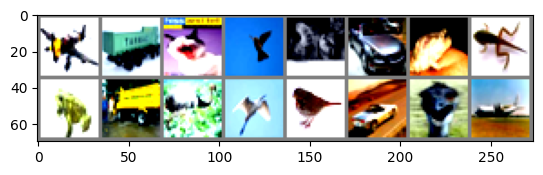

Etichette reali:  plane truck cat   bird  cat   car   frog  frog  frog  truck bird  bird  bird  car   bird  plane
Etichette previste:  plane truck dog   bird  cat   car   frog  bird  frog  truck deer  bird  bird  car   bird  plane


In [206]:
device = torch.device("mps" if torch.backends.mps.is_available() else "cuda" if torch.cuda.is_available() else "cpu")

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

test_dataset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=128, shuffle=True, num_workers=4)

model = CustomResNet(num_classes=10).to(device)
model_load_path = "/Users/pat/Desktop/Thesis/custom_resnet_cifar10.pth"
model.load_state_dict(torch.load(model_load_path))
model.eval() 

def imshow(img):
    img = img / 2 + 0.5  
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

classes = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

dataiter = iter(test_loader)
images, labels = next(dataiter)

imshow(torchvision.utils.make_grid(images))

print('Actual Labels: ', ' '.join(f'{classes[labels[j]]:5s}' for j in range(16)))

outputs = model(images.to(device))
_, predicted = torch.max(outputs, 1)

# Mostra le etichette previste
print('Foreseen Labels: ', ' '.join(f'{classes[predicted[j]]:5s}' for j in range(16)))

### CUSTOM ADAM TRAINING

In [257]:

class AdamOptimizer:
    def __init__(self, learning_rate=0.001, beta1=0.9, beta2=0.999, epsilon=1e-8):
        self.learning_rate = learning_rate
        self.beta1 = beta1
        self.beta2 = beta2
        self.epsilon = epsilon
        self.m = {} 
        self.v = {}
        self.t = 0
    
    def update(self, grad: torch.Tensor, params: torch.Tensor, param_key: str) -> torch.Tensor:
        if param_key not in self.m:
            self.m[param_key] = torch.zeros_like(grad, device=grad.device)
            self.v[param_key] = torch.zeros_like(grad, device=grad.device)

        self.t += 1

        self.m[param_key] = self.beta1 * self.m[param_key] + (1 - self.beta1) * grad
        self.v[param_key] = self.beta2 * self.v[param_key] + (1 - self.beta2) * grad.pow(2)

        m_hat = self.m[param_key] / (1 - self.beta1 ** self.t)
        v_hat = self.v[param_key] / (1 - self.beta2 ** self.t)

        params_update = self.learning_rate * m_hat / (v_hat.sqrt() + self.epsilon)

        return params - params_update
    
def adam_optimization(
    func_class,
    initial_params: np.ndarray,
    learning_rate: float = 0.001,
    beta1: float = 0.9,
    beta2: float = 0.999,
    epsilon: float = 1e-8,
    tolerance: float = 1e-5,
    max_iterations: int = 10000
):
    optimizer = AdamOptimizer(learning_rate, beta1, beta2, epsilon)
    params = initial_params
    history_points = []
    history_values = []
    
    start_time = time.time()
    iteration = 0
    
    while iteration < max_iterations:
        grad = func_class.grad(params)
        grad_norm = np.linalg.norm(grad)
        
        history_points.append(params.copy())
        history_values.append(func_class.func(params))
        
        if grad_norm < tolerance:
            break
        
        params = optimizer.update(grad, params)
        iteration += 1
    
    end_time = time.time()
    execution_time = end_time - start_time
    
    return params, history_points, history_values, execution_time

def find_best_lr_for_path(
    func_class,
    initial_params: np.ndarray,
    learning_rates: list,
    tolerance: float = 1e-5,
    max_iterations: int = 100
) -> typing.Tuple[float, np.ndarray, list, list, float]:
    
    best_lr = None
    best_final_value = float('inf')
    best_history_points = []
    best_history_values = []
    best_params = None

    start_time = time.time()  

    for lr in learning_rates:
        optimal_params, history_points, history_values, _ = adam_optimization(
            func_class,
            initial_params,
            learning_rate=lr,
            tolerance=tolerance,
            max_iterations=max_iterations
        )
        
        final_value = history_values[-1]
        
        if final_value < best_final_value:
            best_final_value = final_value
            best_lr = lr
            best_history_points = history_points
            best_history_values = history_values
            best_params = optimal_params
    
    total_exec_time = time.time() - start_time  
    
    return best_lr, best_params, best_history_points, best_history_values, total_exec_time

In [260]:
model = CustomResNet(num_classes=10).to(device)
print("Model initialised.")
print("Loss function definition...")
criterion = nn.CrossEntropyLoss()
print("Loss function defined.")

Model initialised.
Loss function definition...
Loss function defined.


In [261]:
def train_model_custom_optimizer(model, train_loader, val_loader, criterion, learning_rate=0.001, num_epochs=50):
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []

    optimizer = AdamOptimizer(learning_rate=learning_rate)
    
    start_time = time.time()

    for epoch in range(num_epochs):
        print(f"\nStarting epoch {epoch + 1}/{num_epochs}...")
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        progress_bar = tqdm(enumerate(train_loader), total=len(train_loader), desc=f"Epoch {epoch+1}/{num_epochs} (Training)")

        for i, (inputs, targets) in progress_bar:
            inputs, targets = inputs.to(device), targets.to(device)

            outputs = model(inputs)
            loss = criterion(outputs, targets)

            model.zero_grad()  
            loss.backward()  

            for param_key, param in enumerate(model.parameters()):
                if param.grad is not None:
                    param.data = optimizer.update(param.grad.data, param.data, str(param_key))

            running_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == targets).sum().item()
            total += targets.size(0)

            progress_bar.set_postfix({
                'Train Loss': f'{running_loss / (i+1):.4f}',
                'Train Accuracy': f'{100. * correct / total:.2f}%'
            })

        train_loss = running_loss / len(train_loader)
        train_accuracy = 100. * correct / total
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)

        model.eval()
        val_running_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for i, (inputs, targets) in enumerate(val_loader):
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                val_running_loss += loss.item()

                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == targets).sum().item()
                val_total += targets.size(0)

        val_loss = val_running_loss / len(val_loader)
        val_accuracy = 100. * val_correct / val_total
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        print(f"Epoch {epoch + 1} completed. Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%")

    end_time = time.time()
    print(f"Training completed in {end_time - start_time:.2f} seconds")

    return train_losses, train_accuracies, val_losses, val_accuracies

def plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies):
    print("Plots creation...")
    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, 'b', label='Training Loss')
    plt.plot(epochs, val_losses, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracies, 'b', label='Training Accuracy')
    plt.plot(epochs, val_accuracies, 'r', label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy (%)')
    plt.legend()

    plt.show()
    print("Plots created.")

In [259]:
print("Starting training...")
train_losses, train_accuracies, val_losses, val_accuracies = train_model_custom_optimizer(
    model, train_loader, val_loader, criterion, learning_rate=0.001, num_epochs=50
)
print("Training complete.")

plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies)

model_save_path = "/Users/pat/Desktop/Thesis/custom_adam_resnet_cifar10.pth"
torch.save(model.state_dict(), model_save_path)
print(f"Model saved at {model_save_path}")


Starting epoch 1/10...


Epoch 1/10 (Training): 100%|██████████| 391/391 [00:17<00:00, 22.02it/s, Train Loss=2.6323, Train Accuracy=12.30%]


Epoch 1 completed. Train Loss: 2.6323, Train Accuracy: 12.30%, Val Loss: 2.1748, Val Accuracy: 19.54%

Starting epoch 2/10...


Epoch 2/10 (Training): 100%|██████████| 391/391 [00:16<00:00, 23.13it/s, Train Loss=2.1794, Train Accuracy=16.19%]


Epoch 2 completed. Train Loss: 2.1794, Train Accuracy: 16.19%, Val Loss: 2.0371, Val Accuracy: 22.13%

Starting epoch 3/10...


Epoch 3/10 (Training): 100%|██████████| 391/391 [00:16<00:00, 23.48it/s, Train Loss=2.0865, Train Accuracy=18.63%]


Epoch 3 completed. Train Loss: 2.0865, Train Accuracy: 18.63%, Val Loss: 1.9275, Val Accuracy: 26.83%

Starting epoch 4/10...


Epoch 4/10 (Training): 100%|██████████| 391/391 [00:16<00:00, 23.38it/s, Train Loss=1.9947, Train Accuracy=21.40%]


Epoch 4 completed. Train Loss: 1.9947, Train Accuracy: 21.40%, Val Loss: 1.9230, Val Accuracy: 27.04%

Starting epoch 5/10...


Epoch 5/10 (Training): 100%|██████████| 391/391 [00:16<00:00, 23.32it/s, Train Loss=1.9270, Train Accuracy=24.03%]


Epoch 5 completed. Train Loss: 1.9270, Train Accuracy: 24.03%, Val Loss: 1.7867, Val Accuracy: 29.56%

Starting epoch 6/10...


Epoch 6/10 (Training): 100%|██████████| 391/391 [00:16<00:00, 23.56it/s, Train Loss=1.8655, Train Accuracy=26.73%]


Epoch 6 completed. Train Loss: 1.8655, Train Accuracy: 26.73%, Val Loss: 1.7632, Val Accuracy: 32.01%

Starting epoch 7/10...


Epoch 7/10 (Training): 100%|██████████| 391/391 [00:16<00:00, 23.52it/s, Train Loss=1.8082, Train Accuracy=29.74%]


Epoch 7 completed. Train Loss: 1.8082, Train Accuracy: 29.74%, Val Loss: 1.6771, Val Accuracy: 34.90%

Starting epoch 8/10...


Epoch 8/10 (Training): 100%|██████████| 391/391 [00:16<00:00, 23.38it/s, Train Loss=1.7516, Train Accuracy=31.71%]


Epoch 8 completed. Train Loss: 1.7516, Train Accuracy: 31.71%, Val Loss: 1.6548, Val Accuracy: 36.54%

Starting epoch 9/10...


Epoch 9/10 (Training): 100%|██████████| 391/391 [00:16<00:00, 23.40it/s, Train Loss=1.6945, Train Accuracy=34.35%]


Epoch 9 completed. Train Loss: 1.6945, Train Accuracy: 34.35%, Val Loss: 1.6137, Val Accuracy: 39.13%

Starting epoch 10/10...


Epoch 10/10 (Training): 100%|██████████| 391/391 [00:16<00:00, 23.45it/s, Train Loss=1.6447, Train Accuracy=37.41%]


Epoch 10 completed. Train Loss: 1.6447, Train Accuracy: 37.41%, Val Loss: 1.5970, Val Accuracy: 40.43%
Training completed in 176.19 seconds


### CUSTOM GADAM TRAINING

In [75]:
class GadamOptimizer:
    def __init__(self, model, population_size=10, learning_rate=0.001, beta1=0.9, beta2=0.999, epsilon=1e-8, weight_decay=0.01):
        self.model = model.to(device) 
        self.population_size = population_size
        self.learning_rate = learning_rate
        self.beta1 = beta1
        self.beta2 = beta2
        self.epsilon = epsilon
        self.weight_decay = weight_decay

        self.population = []
        self.m = []  
        self.s = [] 
        self.t = 0

        self.population_history = []

    def initialize_population(self):
        """Initializes the population of models with Xavier initialization."""
        for _ in range(self.population_size):
            new_model = deepcopy(self.model).to(device)  
            for param in new_model.parameters():
                if param.dim() > 1:  
                    torch.nn.init.xavier_uniform_(param)
                else:
                    param.data = torch.zeros_like(param, device=device)  
            self.population.append(new_model)

            self.m.append([torch.zeros_like(param, device=device) for param in new_model.parameters()])
            self.s.append([torch.zeros_like(param, device=device) for param in new_model.parameters()])

    def selection(self, fitness_scores):
        """Selects the top half of the population based on fitness scores."""
        selected_indices = np.argsort(fitness_scores)[-self.population_size // 2:]
        return [self.population[i] for i in selected_indices]

    def crossover(self, parent1, parent2):
        """Performs crossover between two parent models to create an offspring."""
        child_model = deepcopy(self.model).to(device)  
        for p1, p2, child_param in zip(parent1.parameters(), parent2.parameters(), child_model.parameters()):
            mask = torch.rand(1, device=device) > 0.5  
            child_param.data = mask * p1.data + (~mask) * p2.data  
        return child_model

    def mutate(self, individual, mutation_rate=0.25):
        """Applica mutazioni a una parte del modello, riducendo la quantità di modifiche."""
        for param in individual.parameters():
            if random.random() < mutation_rate:  
                mutation = torch.randn_like(param, device=device) * 0.01  
                param.data.add_(mutation)

    def apply_genetic_operations(self, fitness_scores):
        """Applies selection, crossover, and mutation to create a new population."""
        new_population = []
        selected_population = self.selection(fitness_scores)
        
        while len(new_population) < self.population_size:
            parent1, parent2 = random.sample(selected_population, 2)
            offspring = self.crossover(parent1, parent2)
            self.mutate(offspring)
            new_population.append(offspring)
        
        self.population = new_population

    def evaluate_population(self, criterion, train_loader, sample_size=32):
        """Evaluates the fitness of the population using a subset of the training set."""
        fitness_scores = []
        sampled_loader = random.sample(list(train_loader), sample_size)  

        for model in self.population:
            model.eval()
            total_loss = 0.0
            with torch.no_grad():
                for inputs, targets in sampled_loader:  
                    inputs, targets = inputs.to(device), targets.to(device)  
                    outputs = model(inputs)
                    loss = criterion(outputs, targets)
                    total_loss += loss.item()
            fitness_scores.append(1 / (total_loss + 1e-3))  
        return fitness_scores

    def update(self, grad_list):
        """Updates the population using the Adam optimizer without deepcopy."""
        self.t += 1

        for i, model in enumerate(self.population):
            for param, grad, m, s in zip(model.parameters(), grad_list[i], self.m[i], self.s[i]):
                m = self.beta1 * m + (1 - self.beta1) * grad
                s = self.beta2 * s + (1 - self.beta2) * grad ** 2

                m_hat = m / (1 - self.beta1 ** self.t)
                s_hat = s / (1 - self.beta2 ** self.t)

                param_update = self.learning_rate * m_hat / (torch.sqrt(s_hat) + self.epsilon)
                param.data -= param_update + self.weight_decay * param.data

            self.m[i] = [m.detach().clone() for m in self.m[i]]
            self.s[i] = [s.detach().clone() for s in self.s[i]]

    def optimize(self, criterion, train_loader, num_generations=10):
        """Runs the genetic algorithm for a given number of generations."""
        self.initialize_population()

        for generation in range(num_generations):
            fitness_scores = self.evaluate_population(criterion, train_loader)
            self.apply_genetic_operations(fitness_scores)
            grad_list = self.calculate_gradients(criterion, train_loader)
            self.update(grad_list)

    def calculate_gradients(self, criterion, train_loader):
        """Calcola i gradienti per l'intera popolazione in modo più efficiente."""
        grad_list = []
        for model in self.population:
            model.train()
            model.zero_grad()

            inputs, targets = next(iter(train_loader))
            inputs, targets = inputs.to(device), targets.to(device)  
            
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            loss.backward()

            grad_list.append([param.grad for param in model.parameters()])
        return grad_list

In [76]:
model = CustomResNet(num_classes=10).to(device)
print("Model initialised.")
print("Loss function definition...")
criterion = nn.CrossEntropyLoss()
print("Loss function defined.")

Model initialised.
Loss function definition...
Loss function defined.


In [77]:
def train_model_gadam(model, train_loader, val_loader, criterion, num_epochs=80, population_size=10, learning_rate=0.001):
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []

    optimizer = GadamOptimizer(model, population_size=population_size, learning_rate=learning_rate)

    start_time = time.time()

    optimizer.initialize_population()

    for epoch in range(num_epochs):
        print(f"\nStarting epoch {epoch + 1}/{num_epochs}...")
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        progress_bar = tqdm(enumerate(train_loader), total=len(train_loader), desc=f"Epoch {epoch+1}/{num_epochs} (Training)")

        for i, (inputs, targets) in progress_bar:
            inputs, targets = inputs.to(device), targets.to(device)

            fitness_scores = optimizer.evaluate_population(criterion, train_loader)

            optimizer.apply_genetic_operations(fitness_scores)
            grad_list = optimizer.calculate_gradients(criterion, train_loader)
            optimizer.update(grad_list)

            outputs = optimizer.population[0](inputs)  
            loss = criterion(outputs, targets)

            running_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == targets).sum().item()
            total += targets.size(0)

            progress_bar.set_postfix({
                'Train Loss': f'{running_loss / (i+1):.4f}',
                'Train Accuracy': f'{100. * correct / total:.2f}%'
            })

        train_loss = running_loss / len(train_loader)
        train_accuracy = 100. * correct / total
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)

        # Validazione
        model.eval()
        val_running_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for i, (inputs, targets) in enumerate(val_loader):
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = optimizer.population[0](inputs) 
                loss = criterion(outputs, targets)
                val_running_loss += loss.item()

                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == targets).sum().item()
                val_total += targets.size(0)

        val_loss = val_running_loss / len(val_loader)
        val_accuracy = 100. * val_correct / val_total
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        print(f"Epoch {epoch + 1} completed. Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%")

    end_time = time.time()
    print(f"Training completed in {end_time - start_time:.2f} seconds")

    return train_losses, train_accuracies, val_losses, val_accuracies

In [ ]:
train_losses, train_accuracies, val_losses, val_accuracies = train_model_gadam(
    model, train_loader, val_loader, criterion, num_epochs=20, population_size=25, learning_rate=0.001
)

plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies)

### CUSTOM BFGS TRAINING

In [4]:
device = torch.device("mps")
print(f"Using device: {device}")

transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomCrop(32, padding=4),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

train_dataset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)

val_dataset = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False)

criterion = torch.nn.CrossEntropyLoss()

Using device: mps
Files already downloaded and verified
Files already downloaded and verified


In [5]:
model = CustomResNet(num_classes=10).to(device)
print("Model initialised.")

Model initialised.


In [6]:
class BFGSOptimizer:
    def __init__(self, learning_rate=0.001):
        self.learning_rate = learning_rate
        self.hessian_inv = {}

    def update(self, grad: torch.Tensor, params: torch.Tensor, param_key: str) -> torch.Tensor:
        if param_key not in self.hessian_inv:
            flattened_size = grad.numel()  
            self.hessian_inv[param_key] = torch.eye(flattened_size, device=grad.device)

        grad_flat = grad.view(-1)
        params_flat = params.view(-1)

        direction = -torch.matmul(self.hessian_inv[param_key], grad_flat)

        new_params_flat = params_flat + self.learning_rate * direction

        return new_params_flat.view_as(params)
    
def train_model_custom_bfgs(model, train_loader, val_loader, criterion, learning_rate=1.0, num_epochs=50):
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []

    optimizer = BFGSOptimizer(learning_rate=learning_rate)
    
    start_time = time.time()

    for epoch in range(num_epochs):
        print(f"\nStarting epoch {epoch + 1}/{num_epochs}...")
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        progress_bar = tqdm(enumerate(train_loader), total=len(train_loader), desc=f"Epoch {epoch+1}/{num_epochs} (Training)")

        for i, (inputs, targets) in progress_bar:
            inputs, targets = inputs.to(device), targets.to(device)

            outputs = model(inputs)
            loss = criterion(outputs, targets)

            model.zero_grad()  
            loss.backward() 

            for param_key, param in enumerate(model.parameters()):
                if param.grad is not None:
                    param.data = optimizer.update(param.grad.data, param.data, str(param_key))

            running_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == targets).sum().item()
            total += targets.size(0)

            progress_bar.set_postfix({
                'Train Loss': f'{running_loss / (i+1):.4f}',
                'Train Accuracy': f'{100. * correct / total:.2f}%'
            })

        train_loss = running_loss / len(train_loader)
        train_accuracy = 100. * correct / total
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)

        model.eval()
        val_running_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for i, (inputs, targets) in enumerate(val_loader):
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, targets)
                val_running_loss += loss.item()

                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == targets).sum().item()
                val_total += targets.size(0)

        val_loss = val_running_loss / len(val_loader)
        val_accuracy = 100. * val_correct / val_total
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        print(f"Epoch {epoch + 1} completed. Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%")

    end_time = time.time()
    print(f"Training completed in {end_time - start_time:.2f} seconds")

    return train_losses, train_accuracies, val_losses, val_accuracies

def plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies):
    print("Plots creation...")
    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(14, 7))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, 'b', label='Training Loss')
    plt.plot(epochs, val_losses, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracies, 'b', label='Training Accuracy')
    plt.plot(epochs, val_accuracies, 'r', label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy (%)')
    plt.legend()

    plt.show()
    print("Plots created.")

print("Starting training with BFGS...")
train_losses, train_accuracies, val_losses, val_accuracies = train_model_custom_bfgs(
    model, train_loader, val_loader, criterion, learning_rate=1.0, num_epochs=50
)
print("Training complete.")

plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies)

model_save_path = "/Users/pat/Desktop/Thesis/bfgs_resnet_cifar10.pth"
torch.save(model.state_dict(), model_save_path)
print(f"Model saved at {model_save_path}")

Starting training with BFGS...

Starting epoch 1/50...


Epoch 1/50 (Training):   0%|          | 0/391 [00:03<?, ?it/s]


RuntimeError: Invalid buffer size: 20.25 GB

### Plot for LATEX

In [ ]:
import sys
sys.path.append('/Users/pat/PlotNeuralNet/pycore')

from tikzeng import *
from blocks import *

def to_FullyConnected(name, s_filer, n_filer, offset="(0,0,0)", to="(0,0,0)", caption=" "):
    return r"""
    \pic[shift={ """ + offset + """ }] at """ + to + """ 
        {RightBandedBox={
            name=""" + name + """,
            caption=""" + caption + """,
            xlabel={{""" + str(n_filer) + """}},
            zlabel=""" + str(s_filer) + """,
            fill=\\FcColor,
            bandfill=\\FcReluColor,
            height=""" + str(s_filer / 50) + """,  % Altezza proporzionale a s_filer
            width=4,  % Larghezza fissa per renderli più spessi
            depth=4   % Profondità fissa per renderli più spessi
            }
        };
    """

def to_Output(name, s_filer, n_filer, offset="(0,0,0)", to="(0,0,0)", caption="Output"):
    return r"""
    \pic[shift={ """ + offset + """ }] at """ + to + """ 
        {RightBandedBox={
            name=""" + name + """,
            caption=""" + caption + """,
            xlabel={{""" + str(n_filer) + """}},
            zlabel=""" + str(s_filer) + """,
            fill=\\SoftmaxColor,
            height=1,
            width=1,
            depth=1
            }
        };
    """
def to_SkipConnection(from_layer, to_layer, pos_ofs="(0,0,0)"):
    return r"""
    \path[draw, thick, dashed, ->] (""" + from_layer + """-north) -- ++""" + pos_ofs + """ |- (""" + to_layer + """-west);
    """

arch = [
    to_head('..'),
    to_cor(),
    to_begin(),

    # Input layer
    to_input('images/cifar10.png', width=8, height=8),

    # Initial conv layer
    to_ConvConvRelu(name='conv1', s_filer=112, n_filer=(64, 64), offset="(0,0,0)", to="(0,0,0)", width=(2, 2), height=40, depth=40, caption="Conv1 (7x7, 64)"),
    to_Pool(name="maxpool1", offset="(0,0,0)", to="(conv1-east)", width=1, height=20, depth=20, opacity=0.5, caption="MaxPool (3x3)"),

    # Residual Block 1 (layer1)
    to_ConvConvRelu(name='res1_conv1', s_filer=56, n_filer=(64, 64), offset="(2,0,0)", to="(maxpool1-east)", width=(2, 2), height=20, depth=20, caption="Conv1 (3x3, 64)"),
    to_ConvConvRelu(name='res1_conv2', s_filer=56, n_filer=(64, 64), offset="(2,0,0)", to="(res1_conv1-east)", width=(2, 2), height=20, depth=20, caption="Conv2 (3x3, 64)"),
    to_Sum(name="res1_sum", offset="(2,0,0)", to="(res1_conv2-east)", radius=1.5, opacity=0.6),
    to_connection("maxpool1", "res1_conv1"),
    to_SkipConnection(from_layer="maxpool1", to_layer="res1_sum", pos_ofs="(0,0,0)"),

    # Residual Block 2 (layer2)
    to_ConvConvRelu(name='res2_conv1', s_filer=28, n_filer=(128, 128), offset="(2,0,0)", to="(res1_sum-east)", width=(4, 4), height=10, depth=10, caption="Conv1 (3x3, 128)"),
    to_ConvConvRelu(name='res2_conv2', s_filer=28, n_filer=(128, 128), offset="(2,0,0)", to="(res2_conv1-east)", width=(4, 4), height=10, depth=10, caption="Conv2 (3x3, 128)"),
    to_Sum(name="res2_sum", offset="(2,0,0)", to="(res2_conv2-east)", radius=1.5, opacity=0.6),
    to_connection("res1_sum", "res2_conv1"),
    to_SkipConnection(from_layer="res1_sum", to_layer="res2_sum", pos_ofs="(0,0,0)"),

    # Residual Block 3 (layer3)
    to_ConvConvRelu(name='res3_conv1', s_filer=14, n_filer=(256, 256), offset="(2,0,0)", to="(res2_sum-east)", width=(8, 8), height=5, depth=5, caption="Conv1 (3x3, 256)"),
    to_ConvConvRelu(name='res3_conv2', s_filer=14, n_filer=(256, 256), offset="(2,0,0)", to="(res3_conv1-east)", width=(8, 8), height=5, depth=5, caption="Conv2 (3x3, 256)"),
    to_Sum(name="res3_sum", offset="(2,0,0)", to="(res3_conv2-east)", radius=1.5, opacity=0.6),
    to_connection("res2_sum", "res3_conv1"),
    to_SkipConnection(from_layer="res2_sum", to_layer="res3_sum", pos_ofs="(0,0,0)"),

    # Residual Block 4 (layer4)
    to_ConvConvRelu(name='res4_conv1', s_filer=7, n_filer=(512, 512), offset="(2,0,0)", to="(res3_sum-east)", width=(16, 16), height=2.5, depth=2.5, caption="Conv1 (3x3, 512)"),
    to_ConvConvRelu(name='res4_conv2', s_filer=7, n_filer=(512, 512), offset="(2,0,0)", to="(res4_conv1-east)", width=(16, 16), height=2.5, depth=2.5, caption="Conv2 (3x3, 512)"),
    to_Sum(name="res4_sum", offset="(2,0,0)", to="(res4_conv2-east)", radius=1.5, opacity=0.6),
    to_connection("res3_sum", "res4_conv1"),
    to_SkipConnection(from_layer="res3_sum", to_layer="res4_sum", pos_ofs="(0,0,0)"),

    # Global Average Pooling
    to_Pool(name="avgpool", offset="(2,0,0)", to="(res4_sum-east)", width=1, height=1, depth=1, opacity=0.5, caption="AvgPool (1x1)"),

    # Fully Connected Layers
    to_FullyConnected(name="fc1", s_filer=512, n_filer=256, offset="(2,0,0)", to="(avgpool-east)", caption="FC1"),
    to_connection("avgpool", "fc1"),
    to_FullyConnected(name="fc2", s_filer=256, n_filer=128, offset="(2,0,0)", to="(fc1-east)", caption="FC2"),
    to_connection("fc1", "fc2"),
    to_FullyConnected(name="fc3", s_filer=128, n_filer=10, offset="(2,0,0)", to="(fc2-east)", caption="FC3"),
    to_connection("fc2", "fc3"),

    # Output Layer
    to_Output(name="output", s_filer=10, n_filer=10, offset="(2,0,0)", to="(fc3-east)", caption="Output"),
    to_connection("fc3", "output"),

    to_end()
]
def main():
    namefile = str(sys.argv[0]).split('.')[0]
    to_generate(arch, namefile + '.tex')

if __name__ == '__main__':
    main()